<a href="https://colab.research.google.com/github/MarioSigal/Elementos-de-Reconocimiento-Visual/blob/main/TP/Proyecto_Final_ERV_Deteccion_de_Vehiculos_en_Carretera.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

*Nombre de Grupos*: Nosotres

*Integrantes*:

*Fecha de Entrea* : 22 / 12 / 2025

# ***Proyecto Final*** *Elementos de Reconocimiento Visual 2do Cuatrimestre 2025*

Para este trabajo utilizaremos el dataset de Kaggle [Vehicle Detection Image Dataset](https://www.kaggle.com/datasets/pkdarabi/vehicle-detection-image-dataset), el contiene imagenes de vehiculos con sus respectivas categorias y bounding boxes (Cajas que delimitan a un objeto).

El proyecto contara de dos partes:

*   Segmentacion y extraccion de vehiculos en movimiento de un video corto
    * Dado un video encontrar en cada Frame los vehiculos en movimiento, devolviendo las Bounding Boxes que contienen a cada uno.  
*   Clasificacion de vehiculos
    * Dado un recorte de una imagen (64x64), indicar que tipo de vehiculo que se encuentra en el.

Durante las consignas de implementacion pueden utilizar las funciones de `scikit-image` / `cv` de las tecnicas vistas en clase o ya implementadas en otros Laboratorios.


## **Configuracion del DataSet**

In [ ]:
import kagglehub
import json
from collections import Counter
import re

from collections import defaultdict

# Descargamos el DataSet
ROOT = kagglehub.dataset_download("pkdarabi/vehicle-detection-image-dataset")
print("Path to dataset files:", ROOT)

Using Colab cache for faster access to the 'vehicle-detection-image-dataset' dataset.
Path to dataset files: /kaggle/input/vehicle-detection-image-dataset


In [ ]:
def parse_frame(filename):

    m = re.search(r"frame_(\d+)", filename)
    if not m:
        return None, None

    num = m.group(1)
    frame = int(num)
    return frame

In [ ]:
ANN_PATH = "_annotations.coco.json"

""" Carga la informacion de los distintos conjuntos de datos
- images: Informacion de las imagens
    - id:         Id de la imagen
    - file_name:	Nombre del archivo de la imagen
    - height:	    Altura
    - width:	    Ancho

- annotations: Informacion de Bounding Boxes y Clasificacion
    - image_id:     Imagen a la que pertenece
    - category_id:  Categoria a la que pertenece el vehiculo
    - bbox:         Bounding bow [x, y, ancho, alto]
    - area:         Area de la Caja

- categories: Posibles Categorias

"""
def get_dataset_info(ROOT):
  dataset_information = {}
  conjuntos = ["train", "valid", "test"]

  for conj in conjuntos:
    path = ROOT + "/" + conj + "/" + ANN_PATH
    with open(path, "r") as f:
      coco = json.load(f)

    dataset_information[conj] = {}
    dataset_information[conj]["images"] = coco["images"]
    dataset_information[conj]["annotations"] = coco["annotations"]
    dataset_information[conj]["categories"] = coco["categories"]

  return dataset_information

# Muestra informacion del DataSet
def display_dataset_stats():
  for conj, data in dataset_info.items():
      print("\n" + "="*60)
      print(f"📌 DATASET SPLIT: {conj.upper()}")
      print("="*60)

      images = data["images"]
      anns = data["annotations"]
      cats = data["categories"]

      # --- Datos Basicos ---
      print(f"Numero de Imagenes:       {len(images)}")
      print(f"Numero de Anotaciones:  {len(anns)}")
      print(f"Numero de Categorias:   {len(cats)}")

      # --- Nombres de Categorias ---
      print("\nCategorias:")
      for c in cats:
          print(f" - {c['id']}: {c['name']}")

      # --- Anotaciones por Categoria ---
      ann_count = Counter([ann["category_id"] for ann in anns])
      print("\n📊 Anotaciones por Categoria:")
      for c in cats:
          print(f"{c['name']:15s}: {ann_count[c['id']]}")

      # --- Cajas por Imagen ---
      anns_per_image = Counter([ann["image_id"] for ann in anns])
      values = list(anns_per_image.values())
      avg_boxes = sum(values) / len(images) if images else 0

      print("\n📦 Estadisticas de Bounding Boxes:")
      print(f"Promedio de Cajas por Frame : {avg_boxes:.2f}")
      print(f"Maximo de Cajas por Frame   : {max(values) if values else 0}")
      print(f"Minimo de Cajas por Frame   : {min(values) if values else 0}")

      # --- Stats de Cajas ---
      widths  = [ann["bbox"][2] for ann in anns]
      heights = [ann["bbox"][3] for ann in anns]
      areas   = [w*h for w, h in zip(widths, heights)]

      print("\n🧩 Sizes de Bounding Boxes:")
      print(f"Ancho Promedio  :   {sum(widths)/len(widths):.1f}")
      print(f"Altura Promedio :  {sum(heights)/len(heights):.1f}")
      print(f"Area Promedio   :    {sum(areas)/len(areas):.1f}")

      print("-"*60)


In [ ]:
GRAY_PATH = ROOT + "/Apply_Grayscale/Apply_Grayscale/Vehicles_Detection.v9i.coco"

dataset_info = get_dataset_info(GRAY_PATH)
display_dataset_stats()


📌 DATASET SPLIT: TRAIN
Numero de Imagenes:       136
Numero de Anotaciones:  2724
Numero de Categorias:   6

Categorias:
 - 0: cars
 - 1: Bus
 - 2: Car
 - 3: Motorcycle
 - 4: Pickup
 - 5: Truck

📊 Anotaciones por Categoria:
cars           : 0
Bus            : 31
Car            : 2023
Motorcycle     : 355
Pickup         : 251
Truck          : 64

📦 Estadisticas de Bounding Boxes:
Promedio de Cajas por Frame : 20.03
Maximo de Cajas por Frame   : 52
Minimo de Cajas por Frame   : 1

🧩 Sizes de Bounding Boxes:
Ancho Promedio  :   22.7
Altura Promedio :  30.6
Area Promedio   :    1202.3
------------------------------------------------------------

📌 DATASET SPLIT: VALID
Numero de Imagenes:       28
Numero de Anotaciones:  563
Numero de Categorias:   6

Categorias:
 - 0: cars
 - 1: Bus
 - 2: Car
 - 3: Motorcycle
 - 4: Pickup
 - 5: Truck

📊 Anotaciones por Categoria:
cars           : 0
Bus            : 6
Car            : 398
Motorcycle     : 92
Pickup         : 59
Truck          : 8

📦 Estadi

### **Funciones Auxiliares**

In [ ]:
from skimage import io
import os

# Dado el Frame/Numero de imagen, devuelve el split e informacion de Imagen
def find_image_from(frame):

    for split, data in dataset_info.items():
        for img in data["images"]:

            fname = img["file_name"]
            frm = parse_frame(fname)
            if frm == frame:
              return split, img

    return None, None

# Carga una imagen
def load_image(split, image_info):
    img_path = os.path.join(GRAY_PATH, split, image_info["file_name"])
    return io.imread(img_path)

# Recupera las Bounding Boxes de una imagen
def get_bboxes_for_image(split, image_info):
    annotations = dataset_info[split]["annotations"]
    return [ann for ann in annotations if ann["image_id"] == image_info["id"]]

In [ ]:
import matplotlib.pyplot as plt
from skimage.draw import rectangle_perimeter

# Plotea una imagen junto con sus anotaciones
# categories -> Codigo de Categoria
def draw_bboxes(image, bboxes, categories = []):

    # Mapeo de categoria_id a Nombre
    cat_map = {c["id"]: c["name"] for c in categories}

    img_copy = image.copy()

    # Dibujamos las cajas en la imagen
    for ann in bboxes:
        x, y, w, h = ann["bbox"]
        x, y, w, h = int(x), int(y), int(w), int(h)

        rr, cc = rectangle_perimeter(start=(y, x), end=(y + h, x + w), shape=img_copy.shape)

        # Blanco en Gris, Rojo en RGB
        if img_copy.ndim == 2:
          if img_copy.dtype == float:
            img_copy[rr, cc] = 1
          else:
            img_copy[rr, cc] = 255
        else:
            img_copy[rr, cc] = [255, 0, 0]



    plt.figure(figsize=(10, 10))
    plt.imshow(img_copy, cmap="gray" if img_copy.ndim == 2 else None)

    # Agregamos la Categoria
    ax = plt.gca()

    if cat_map:
      for ann in bboxes:
          x, y, w, h = map(int, ann["bbox"])
          category_id = ann["category_id"]
          label = cat_map.get(category_id, "unknown")

          text_color = "yellow" if img_copy.ndim == 3 else "red"

          ax.text(
              x, y - 3,                # Arriba de la caja
              label,
              color=text_color,
              fontsize=12,
              weight="bold",
              bbox=dict(facecolor="black", alpha=0.5, pad=2)
          )

    plt.axis("off")
    plt.show()


In [ ]:
# Plotea imagen original y binaria lado a lado con sus anotaciones
def draw_bboxes_img_and_binary(image, binary_frame, bboxes, categories=[]):

    # Mapeo de categoria_id a Nombre
    cat_map = {c["id"]: c["name"] for c in categories}

    img_copy = image.copy()
    bin_copy = binary_frame.copy()

    # Asegurar que la binaria sea visible
    if bin_copy.dtype != np.uint8:
        bin_copy = (bin_copy > 0).astype(np.uint8) * 255

    # Dibujamos las cajas en ambas imagenes
    for ann in bboxes:
        x, y, w, h = ann["bbox"]
        x, y, w, h = int(x), int(y), int(w), int(h)

        rr, cc = rectangle_perimeter(
            start=(y, x),
            end=(y + h, x + w),
            shape=img_copy.shape
        )

        # Imagen original
        if img_copy.ndim == 2:
            if img_copy.dtype == float:
                img_copy[rr, cc] = 1
            else:
                img_copy[rr, cc] = 255
        else:
            img_copy[rr, cc] = [255, 0, 0]

        # Imagen binaria (blanco)
        bin_copy[rr, cc] = 255

    plt.figure(figsize=(14, 7))

    # Imagen original
    plt.subplot(1, 2, 1)
    plt.imshow(img_copy, cmap="gray" if img_copy.ndim == 2 else None)
    plt.title("Imagen original")
    plt.axis("off")

    # Imagen binaria
    plt.subplot(1, 2, 2)
    plt.imshow(bin_copy, cmap="gray")
    plt.title("Imagen binaria")
    plt.axis("off")

    # Agregamos la Categoria SOLO en la original
    if cat_map:
        ax = plt.gca()
        for ann in bboxes:
            x, y, w, h = map(int, ann["bbox"])
            category_id = ann["category_id"]
            label = cat_map.get(category_id, "unknown")

            text_color = "yellow" if img_copy.ndim == 3 else "red"

            plt.subplot(1, 2, 1)
            plt.text(
                x, y - 3,
                label,
                color=text_color,
                fontsize=12,
                weight="bold",
                bbox=dict(facecolor="black", alpha=0.5, pad=2)
            )

    plt.show()


In [ ]:
# Dado un Frame/Numero de Imagen, la muestra junto con sus anotaciones
def visualize_frame(frame_number):
    split, img_info = find_image_from(frame_number)

    if img_info is None:
        print("❌ Frame No Encontrado.")
        return

    image = load_image(split, img_info)
    bboxes = get_bboxes_for_image(split, img_info)
    categories = dataset_info[split]["categories"]

    draw_bboxes(image, bboxes, categories)


### ***Ejemplo***

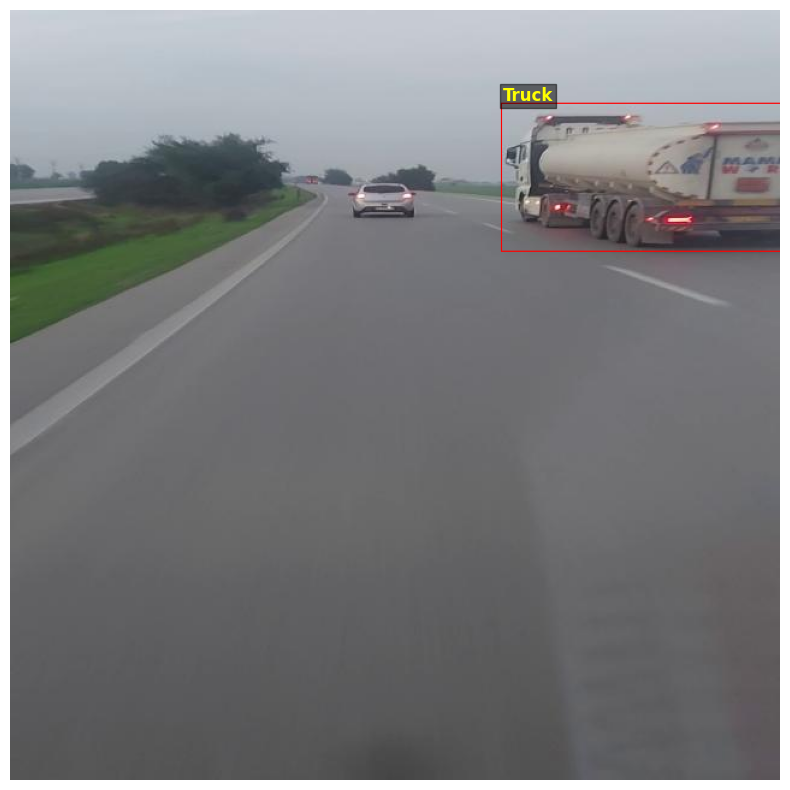

In [ ]:
visualize_frame(4363)

## **Parte 1**: ***Segmentacion en Video***

### **Funciones Auxiliares**

In [ ]:
from skimage.color import rgb2gray
import numpy as np
import math

# Pasa una imagen a gris si es necesario
def to_gray(image):
  if image.ndim == 3:
    return rgb2gray(image)
  return image

# Dada una lista de Frames, devuelve un arreglo de numpy con las imagenes correspondientes
def create_video_from_frame(frames):
  video = []

  for frame in frames:

    split, img_info = find_image_from(frame)
    image = load_image(split, img_info)

    video.append(to_gray(image))

  return np.asarray(video)

# Muestra los Frames de un Video
def plot_video_frames(video_array, frame_numbers, title="Video"):

    num_frames = len(video_array)

    if num_frames == 0:
        print("Error: Arreglo Vacio.")
        return

    # Configuramos el Canvas para agregar las figuras
    cols = math.ceil(math.sqrt(num_frames))
    rows = math.ceil(num_frames / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2.5, rows * 2.5))
    axes = axes.flatten()

    for i in range(num_frames):
        ax = axes[i]
        frame_data = video_array[i]

        ax.imshow(frame_data, cmap='gray')
        ax.set_title(f"Frame #{frame_numbers[i]}", fontsize=10)
        ax.set_xticks([])
        ax.set_yticks([])

    # Sacamos Sobrante
    for j in range(num_frames, len(axes)):
        fig.delaxes(axes[j])

    fig.suptitle(title, fontsize=14, fontweight='bold')
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


### ***Segmentacion y Extraccion***
***Consigna**:*

Deberán diseñar e implementar una función denominada segmentator que cumpla con las siguientes especificaciones:



*   Tome un arreglo que represente los frames de un video corto: $[f_1, f_2, ..., f_n]$, donde $f_i$ es el frame $i$.

*   Retorne una lista anidada que contenga, para cada frame, una sublista de Bounding Boxes correspondientes a los vehículos en movimiento detectados.

Las coordenadas de cada Bounding Box se definen como [x, y, w, h] (coordenada X superior izquierda, coordenada Y superior izquierda, ancho y alto):

$$segmentator([f_1,f_2,...,f_n])=
[
[
[x_{11}, y_{11}, w_{11}, h_{11}],
...,
[x_{1m}, y_{1m}, w_{1m}, h_{1m}]
],
...,
[
[x_{n1}, y_{n1}, w_{n1}, h_{n1}],
...,
[x_{nv}, y_{nv}, w_{nv}, h_{nv}]
]
]$$

Donde:

*   $\textbf{n}$ es el número total de frames en el video.
*   $\textbf{m}$ es el número de vehículos detectados en el primer frame ($f_1$).
*   $\textbf{v}$ es el número de vehículos detectados en el último frame ($f_n$).


***Recomendaciones***

Dividir la tarea en 2 pasos:



*   *Segmentación Binaria* (Fondo vs. Objeto): Primero, realicen una segmentación que permita diferenciar de manera binaria el fondo estático del video de los objetos en movimiento (los vehículos).

*   *Extracción de Propiedades y Bounding Boxes*: Una vez que tengan la máscara binaria, utilicen la función `skimage.measure.regionprops` para identificar y extraer las propiedades de cada región conectada (cada vehículo), incluyendo sus respectivas Bounding Boxes.





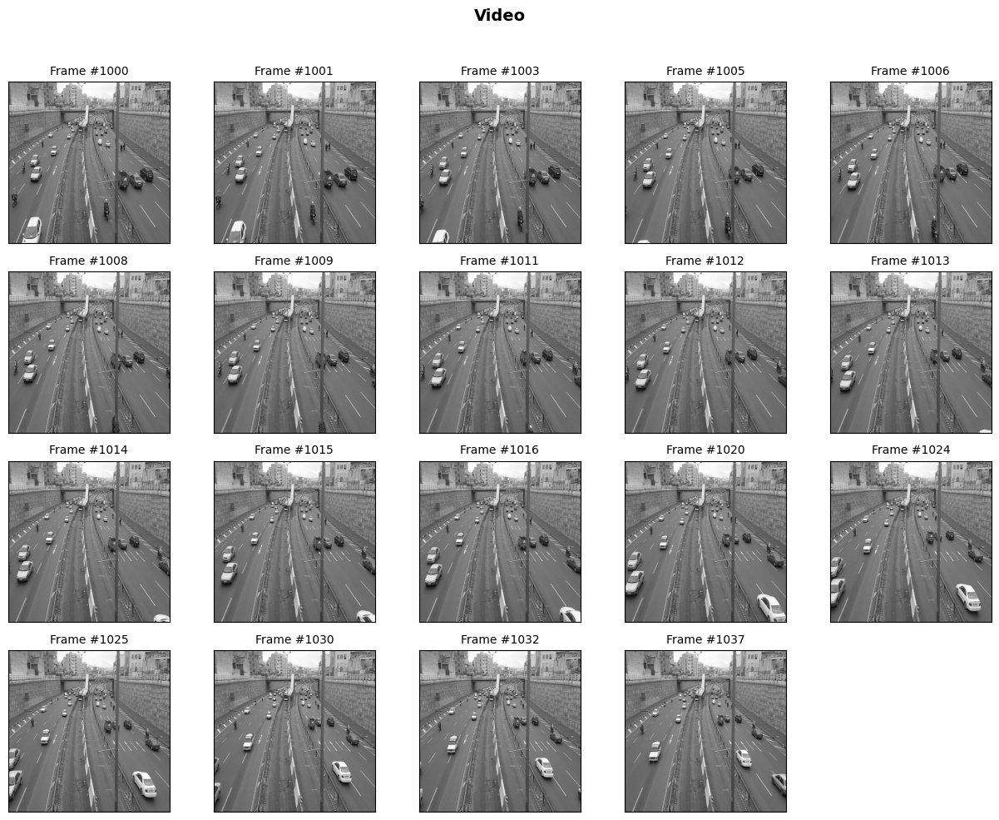

In [ ]:
video_frames = [1000, 1001, 1003, 1005, 1006, 1008, 1009, 1011, 1012, 1013, 1014, 1015, 1016, 1020, 1024, 1025, 1030, 1032, 1037]
video = create_video_from_frame(video_frames)

plot_video_frames(video, video_frames)

#### ***Su Segmentador***

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import color, exposure, img_as_float
from skimage.feature import canny
from skimage.color import rgb2gray
from skimage.filters import threshold_otsu
from skimage.measure import label, regionprops
from skimage.morphology import opening, closing, disk, remove_small_objects, erosion, reconstruction, dilation
from skimage.filters import gaussian

In [ ]:
def segmentacion_binaria(frames, min_area=150, PrintBackground=False):
    """
    frames: lista de frames (ints)
    retorna: lista anidada de bounding boxes por frame
    """
    #1: obtenemos las imagenes de cada frame en escala de grices.
    gray_frames = create_video_from_frame(frames)
    #2: promediamos el fondo
    background = np.median(gray_frames, axis=0)

    if PrintBackground:
      plt.imshow(background, cmap='gray')

    #3: procesamos cada frame
    binary_frames = []
    proced_frames = []

    for frame in gray_frames:

      diff = np.abs(frame - background) # Diferencia absoluta

      try:
        thresh = threshold_otsu(diff) # Threshold automatico
      except ValueError:
        binary_frames.append(np.zeros_like(frame, dtype=bool)) # Si no hay diferencias (vehiculos) no genera bounding boxes (manda todo el binary en 0)
        continue

      binary = diff > 0.5*thresh

      #Limpieza
      binary = opening(binary, disk(2)) #Elimina ruido
      binary = closing(binary, disk(8)) #cierra huecos internos o une regiones cercanas

      binary = remove_small_objects(binary, min_size=min_area) #Borra pixeles conexos de area menor que min_size

      frame_float = img_as_float(frame)

      edges = canny(frame, sigma=1.5)

      edges = dilation(edges, disk(2))

      edges = remove_small_objects(edges, min_size=150)


      binary = binary & edges
      binary = remove_small_objects(binary, min_size=150)

      binary_frames.append(binary)
      proced_frames.append(frame)

    return binary_frames, proced_frames

def Propiedades(binary_image):
    labeled = label(binary_image) # Encuentra componentes conexas y les pone un indice
    props = regionprops(labeled) # Devuelve lista con las caracteristicas de cada componente conexa. area, bbox, etc
    return props

def Bounding_Boxes(props):
    frame_bboxes = []

    for prop in props:
      min_row, min_col, max_row, max_col = prop.bbox

      x = min_col
      y = min_row
      w = max_col - min_col
      h = max_row - min_row

      frame_bboxes.append([x, y, w, h])
    return frame_bboxes

def vehicle_segmentator(frames, RetournBinaryFrames=False, PrintBackground=False):
    binary_frames, proced_frames = segmentacion_binaria(frames, PrintBackground=PrintBackground)

    bboxes = []
    for frame in binary_frames:

      props = Propiedades(frame)

      frame_bboxes = Bounding_Boxes(props)

      bboxes.append(frame_bboxes)
    if RetournBinaryFrames:
      return bboxes, binary_frames, proced_frames
    return bboxes


#vehicle_segmentator(video_frames)

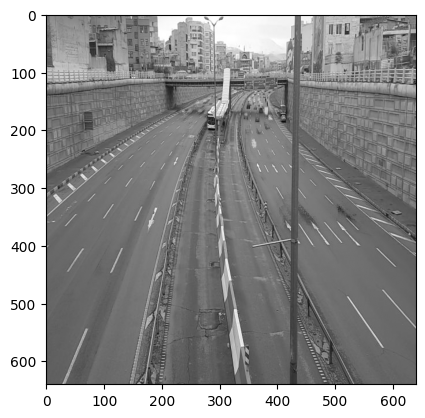

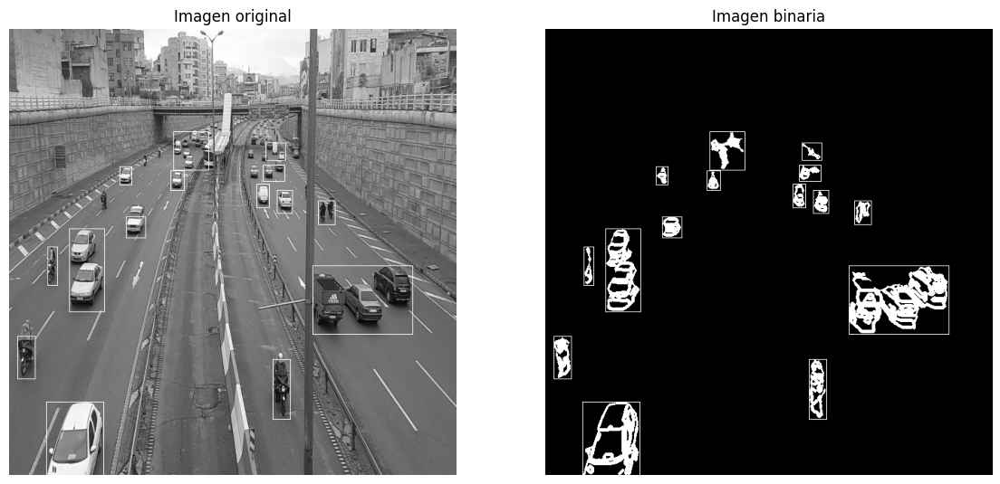

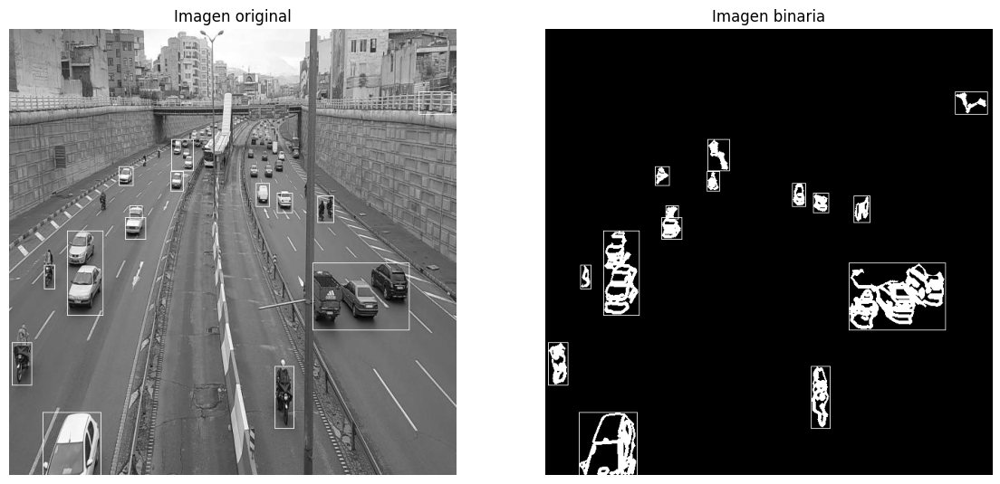

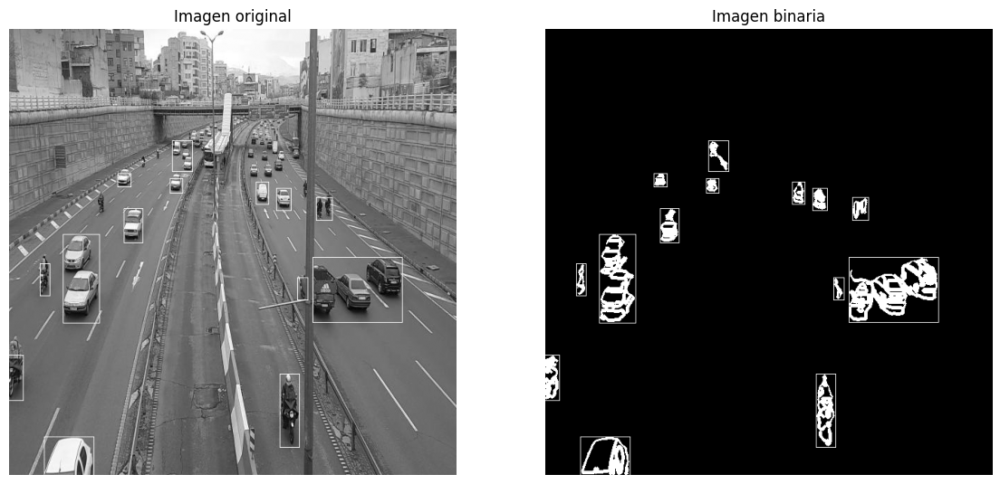

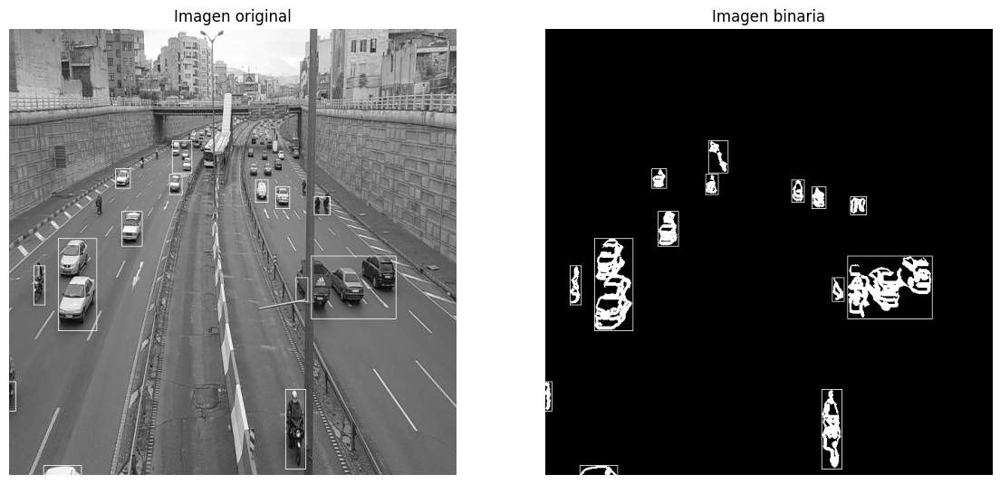

...

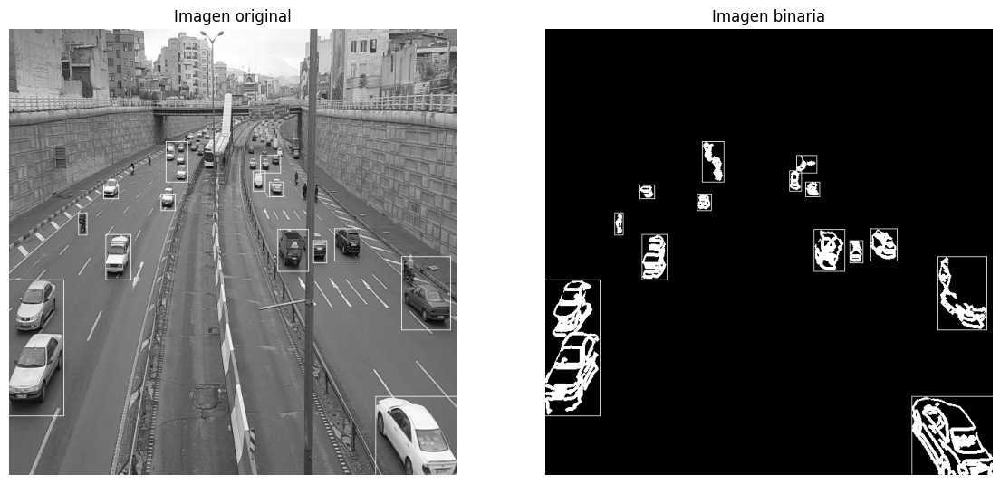

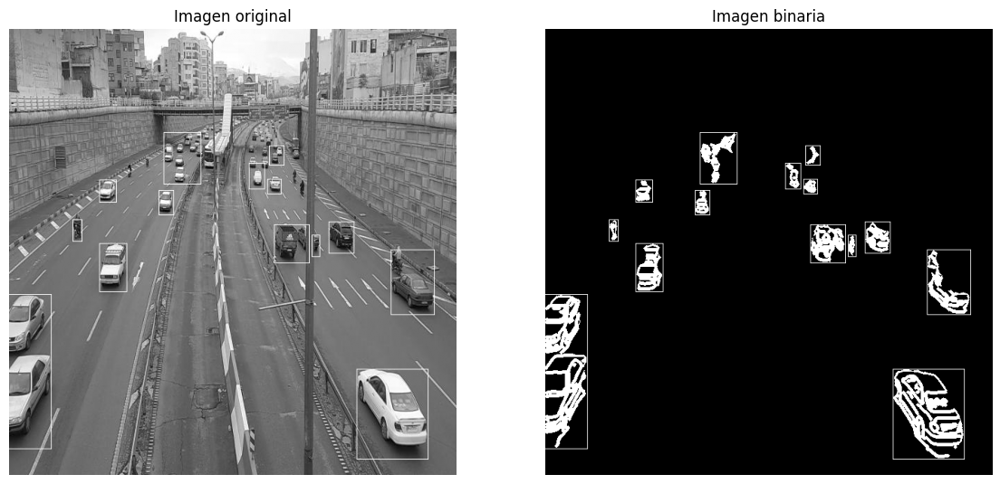

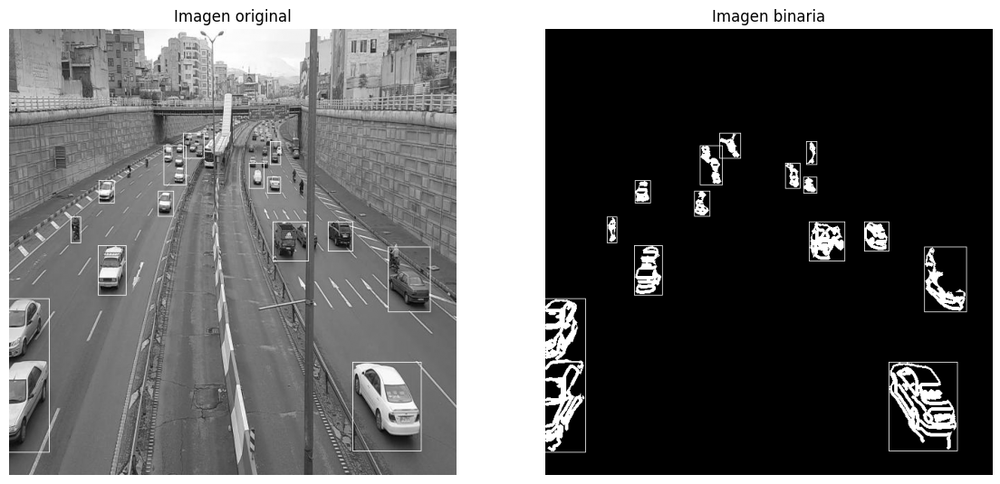

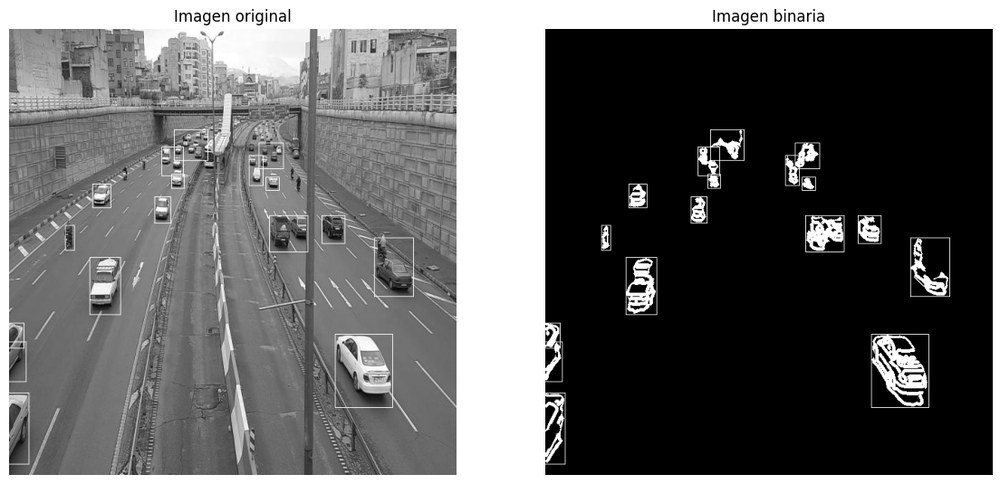

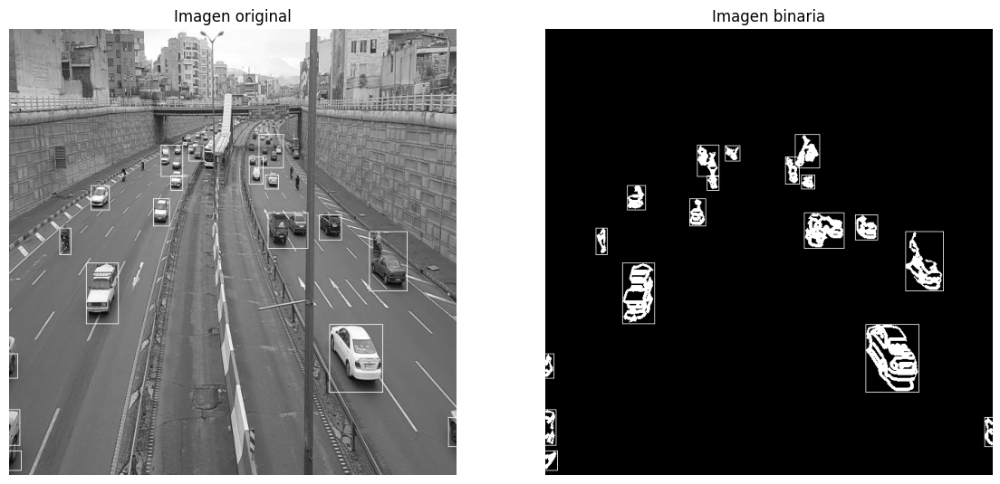

In [ ]:
video = create_video_from_frame(video_frames)
bboxes, binary_frames, proced_frames = vehicle_segmentator(video_frames, RetournBinaryFrames=True, PrintBackground=True)

for frame in range(len(video) - 1):
  annotations = []
  for boxes_frame in bboxes[frame]:
    annotations.append({"bbox" :boxes_frame})

  draw_bboxes_img_and_binary(proced_frames[frame], binary_frames[frame], annotations)

El mecanismo funciona, hay que hacer una buena elección de hiperparametros.

#### ***Evaluacion de Segmentador***

##### Funciones Auxiliares

In [ ]:

# Calcula la Interseccion Sobre Union entre dos Bounding Boxes
# Lo utilizaremos como metrica de cercania
def calculate_iou(boxA, boxB):

    # [x, y, w, h] -> [x_min, y_min, x_max, y_max]
    xA = boxA[0]
    yA = boxA[1]
    xA_max = boxA[0] + boxA[2]
    yA_max = boxA[1] + boxA[3]

    xB = boxB[0]
    yB = boxB[1]
    xB_max = boxB[0] + boxB[2]
    yB_max = boxB[1] + boxB[3]

    # Determinamos el rectangulo de interseccion
    x_intersect_min = max(xA, xB)
    y_intersect_min = max(yA, yB)
    x_intersect_max = min(xA_max, xB_max)
    y_intersect_max = min(yA_max, yB_max)

    # Calculamos el area de interseccion
    inter_w = max(0, x_intersect_max - x_intersect_min)
    inter_h = max(0, y_intersect_max - y_intersect_min)
    inter_area = inter_w * inter_h

    # Area de ambas cajas
    boxA_area = boxA[2] * boxA[3]
    boxB_area = boxB[2] * boxB[3]

    # Area de Union
    union_area = boxA_area + boxB_area - inter_area

    if union_area == 0:
        return 0.0

    return inter_area / union_area

In [ ]:

# Compara las BBoxes encontradas con las reales.
# Encuentra una coincidencia entre una Caja predicha y Verdadera si
# su IoU supera cierto umbral.
# Devuelve True Positives, False Positives, False Negatives
def compare_detection_accuracy(
    pred_boxes,
    annotations,
    iou_threshold=0.5
):

    # Seguimos que Cajas ya fueron detectadas / tuvieron una coincidencia
    matched_gt = [False] * len(annotations)
    true_positives = 0
    false_positives = 0

    # Comparamos cada prediccion con las cajas verdaderas
    for pred_box in pred_boxes:
        best_iou = 0.0
        best_gt_index = -1

        # Calculamos IoU de las no detectadas ya
        for i, ann in enumerate(annotations):
            if not matched_gt[i]:
                iou = calculate_iou(pred_box, ann["bbox"])

                if iou > best_iou:
                    best_iou = iou
                    best_gt_index = i

        # Si alguna caja verdadera supera el iou_threshold, es una coincidencia
        if best_iou >= iou_threshold:

            # True Positive
            true_positives += 1
            matched_gt[best_gt_index] = True

        else:
            # Ninguna Caja verdadera coincide
            # False Positive
            false_positives += 1

    # Las cajas no encontradas son False Negatives
    false_negatives = len(annotations) - true_positives

    return {
        'TP': true_positives,
        'FP': false_positives,
        'FN': false_negatives
    }

In [ ]:

# Dados los numero de imagen de los frames de un Video, el video,
# una funcion de segmentacion y un umbral, Calcula los TP,FP,FP totales
def video_accuracy(video_frames, video, segmentator, iou_threshold = 0.5):

  n_frames = len(video_frames)
  total_tp = 0
  total_fp = 0
  total_fn = 0

  # Realizamos nuestra prediccion
  pred_bboxes = segmentator(video_frames)

  # Por cada uno de los frames excepto el ultimo
  for frame_idx in range(n_frames - 1):

    split, img_info = find_image_from(video_frames[frame_idx])

    bboxes_annotations = get_bboxes_for_image(split, img_info)
    bboxes_frame_pred = pred_bboxes[frame_idx]

    # Conseguimos TP, FP, FN y lo sumamos al contador global
    if img_info:
      results = compare_detection_accuracy(
          bboxes_frame_pred,
          bboxes_annotations,
          iou_threshold=iou_threshold
      )

      total_tp += results['TP']
      total_fp += results['FP']
      total_fn += results['FN']

    return total_tp, total_fp, total_fn

# Mostramos la Evalucion del Segmentador
def show_stats(total_tp, total_fp, total_fn):

  total_predictions = total_tp + total_fp
  total_ground_truth = total_tp + total_fn

  # Precision: TP / (TP + FP)
  precision = total_tp / total_predictions if total_predictions > 0 else 0.0

  # Recall: TP / (TP + FN)
  recall = total_tp / total_ground_truth if total_ground_truth > 0 else 0.0

  # F1-Score: 2 * (Precision * Recall) / (Precision + Recall)
  f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0.0

  print("\n--- Evaluacion del Segmentador ---")
  print(f"Total True Positives (TP): {total_tp}")
  print(f"Total False Positives (FP): {total_fp}")
  print(f"Total False Negatives (FN): {total_fn}")
  print("-" * 35)
  print(f"Precision: {precision:.4f}")
  print(f"Recall: {recall:.4f}")
  print(f"F1-Score: {f1_score:.4f}")
  print("-" * 35)
  print(f"Total Ground Truth Objects (GT): {total_ground_truth}")
  print(f"Total Predicted Objects: {total_predictions}")

##### Evaluacion

In [ ]:
total_tp, total_fp, total_fn = video_accuracy(video_frames, video, vehicle_segmentator, iou_threshold=0.5)
show_stats(total_tp, total_fp, total_fn)


--- Evaluacion del Segmentador ---
Total True Positives (TP): 8
Total False Positives (FP): 7
Total False Negatives (FN): 14
-----------------------------------
Precision: 0.5333
Recall: 0.3636
F1-Score: 0.4324
-----------------------------------
Total Ground Truth Objects (GT): 22
Total Predicted Objects: 15


## **Parte 2: Clasificacion de Vehiculos**

Esta parte estara dividida en 2 secciones:  

*   En la primera deberan realizar un analisis de como la **profundidad** (numero de capas) afecta la precision de una red Convolucional

*   En la segunda implementaran su propio categorizador usando algunas de las tecnicas vistas en clase sin uso de redes neuronales

Para entrenar ambos clasificadores, utilizaremos los recortes de las bounding boxes dados por las anotaciones de cada frame.

### ***Configuracion de DataLoaders***

Los DataLoaders devolveran tensores de 3x64x64 (CxHxW) en escalas de gris.

#### **Funciones Auxiliares**

In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

# Imagenes de 64x64
class VehicleClassificationDataset(Dataset):
    """Dataset de PyTorch para los recortes de las Bounding Boxes."""

    def __init__(self, samples, transform=None):
        """
        Args:
            samples (list): Lista de Diccionarios:
                            {'crop': np.array, 'label': int}
            transform (callable, optional): Transformacions a aplicar sobre cada muestra.
        """
        self.samples = samples

        # Transformaciones por Default:
        # Convertimos la imagen a 64x64
        # La pasamos a gris con 3 canales por convencion
        # La pasamos a formato C X H x W
        # La pasamos a un Tensor

        self.transform = transform if transform else transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize((64, 64)),
            transforms.Grayscale(num_output_channels=3),
            transforms.ToTensor(),
        ])

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        sample = self.samples[idx]
        image_crop = sample['crop']
        label = sample['label']

        # Aplicamos transformaciones
        image_crop = self.transform(image_crop)

        return image_crop, label


# Dado un conjunto del datase, obtiene todos los recortes y las labels
def extract_crops_and_labels(split):

    all_crops = []

    for img_info in dataset_info[split]['images']:

        full_img = load_image(split, img_info)

        #Pasamos a Gris
        if full_img.ndim == 3:
          full_img = rgb2gray(full_img)

        #Conseguimos Anotaciones
        annotations = get_bboxes_for_image(split, img_info)

        # Cortamos cada bbox y lo guardamos
        for ann in annotations:

            x, y, w, h = [int(val) for val in ann['bbox']]

            # Chequeamos que la bbox sea valida
            x_end = min(x + w, full_img.shape[1])
            y_end = min(y + h, full_img.shape[0])
            x = max(0, x)
            y = max(0, y)

            if x_end <= x or y_end <= y:
                continue

            # Realizamos el recorte
            cropped_img = full_img[y:y_end, x:x_end]

            # Guardamos el recorte y su categoria
            all_crops.append({
                'crop': cropped_img,
                'label': ann['category_id']
            })

    return all_crops

In [ ]:

# Crea los DataLoaders para Training, Validation y Test
def create_dataloaders(batch_size=32):

    np.random.seed(42)

    # Extraemos Recortes
    print("Extrayendo Recortes de Training...")
    train_crops = extract_crops_and_labels("train")

    print("Extrayendo Recortes de Validation...")
    valid_crops = extract_crops_and_labels("valid")

    print("Extrayendo Recortes de Test...")
    test_crops = extract_crops_and_labels("test")

    print(f"Total crops: Train={len(train_crops)}, Valid={len(valid_crops)}, Test={len(test_crops)}")

    # 2. Creamos cada DataSet
    train_dataset = VehicleClassificationDataset(train_crops)
    valid_dataset = VehicleClassificationDataset(valid_crops)
    test_dataset = VehicleClassificationDataset(test_crops)

    # 3. Creamos cada Dataloader
    # Set num_workers to 2 as suggested by the warning to prevent potential slowness/freeze
    train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
    valid_dataloader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
    test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

    return train_dataloader, valid_dataloader, test_dataloader

In [ ]:
# Definimos las categorias
CATEGORIES = {
    0: "cars",
    1: "Bus",
    2: "Car",
    3: "Motorcycle",
    4: "Pickup",
    5: "Truck"
}

def numpy_format(images_from_dataloader):

  if images_from_dataloader.ndim == 3:
    imgs = images_from_dataloader.permute(1, 2, 0) # (B, C, H, W) -> (B, H, W, C)
    imgs = torch.clamp(imgs, 0, 1).cpu().numpy()
  else:
    imgs = images_from_dataloader.permute(0, 2, 3, 1) # (B, C, H, W) -> (B, H, W, C)
    imgs = torch.clamp(imgs, 0, 1).cpu().numpy()

  return imgs

# Ploteamos algunos elementos del DataLoader
def plot_dataloader_example(dataloader, title="Muestras de Imagenes Recortadas de DataLoader"):

    # Agarramos el primer Batch
    batch_images, batch_labels = next(iter(dataloader))

    fig, axes = plt.subplots(5, 1, figsize=(12,4))
    axes = axes.flatten()

    for i in range(5):
        ax = axes[i]

        # Convertimos la imagen al formato normal de numpy
        img = numpy_format(batch_images[i])

        # 4. Label
        label_id = batch_labels[i].item()
        label_name = CATEGORIES.get(label_id, "Unknown")

        # 5. Plot
        if img.shape[2] == 1:
             ax.imshow(img.squeeze(), cmap='gray')
        else:
             ax.imshow(img)

        ax.set_title(f"Class: {label_name}", fontsize=10)
        ax.axis('off')

    fig.suptitle(title, fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

#### **Creacion de DataLoaders**

Extrayendo Recortes de Training...
Extrayendo Recortes de Validation...
Extrayendo Recortes de Test...
Total crops: Train=2724, Valid=563, Test=254

PyTorch DataLoaders successfully created!


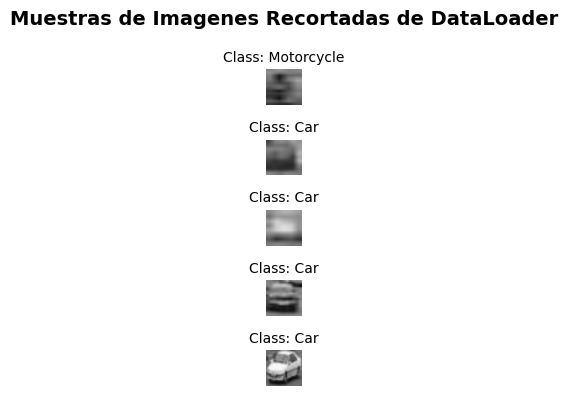

In [ ]:
train_loader, valid_loader, test_loader = create_dataloaders(batch_size=64)
print("\nPyTorch DataLoaders successfully created!")

plot_dataloader_example(train_loader)

### ***Definicion CNN***

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.transforms import Normalize

# Categorias 1-5 (Bus, Car, Motorcycle, Pickup, Truck)
NUM_CLASSES = 5
IMAGE_SIZE = 64
IMAGE_CHANNELS = 3

class BasicCNN(nn.Module):
    """
    Modulo de CNN Basica.
    Arquitectura: Conv -> Pool -> Conv -> Pool -> Linear
    Input: (Batch, 3, 64, 64)
    Output: (Batch, 5)
    """
    def __init__(self):
        super(BasicCNN, self).__init__()

        # Aplicaremos una normalizacion estandar antes de realizar el procesamiento
        self.normalize_transform = transforms.Normalize(
                                      mean=[0.485, 0.456, 0.406],
                                      std=[0.229, 0.224, 0.225]
                                   )

        # --- Extrator de Features (Capas Convolucionales) ---
        # nn.Sequential aplica una serie de operaciones de forma secuencial
        self.features = nn.Sequential(
            # 1. Primer Bloque
            nn.Conv2d(in_channels=IMAGE_CHANNELS, out_channels=16, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2), # Output: 16 x 32 x 32

            # 2. Segundo Bloque
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)  # Output: 32 x 16 x 16
        )

        # --- Clasificador (Capas Lineales) ---
        # Tamano Flattened: 32  * 16 * 16 = 8192

        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(32 * 16 * 16, 512), # Capa Oculta
            nn.ReLU(),
            nn.Linear(512, NUM_CLASSES)   # Output Final (Puntaje para cada Clase)
        )

    def forward(self, x):
        x = self.normalize_transform(x)
        x = self.features(x)
        x = self.classifier(x)
        return x

### **Entrenamiento**

In [ ]:

# Entrena un modelo, dado su Modulo, dataloader de validacion y training
# Cantidad de epochs y lr
def train_model(model, train_loader, valid_loader, num_epochs=10, learning_rate=0.001):

    # 1. Utilizamos la gpu si es posible
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    # Usamos Entropia Cruzada como funcion de Perdida
    criterion = nn.CrossEntropyLoss()
    # Adam como optimizador
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    print(f"Empezando entrenamiento en: {device}")

    # 2. Loop de Entrenamiento
    for epoch in range(1, num_epochs + 1):

        model.train() # Seteamos el modelo en modo entrenamiento
        running_loss = 0.0

        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)

            # Nuestras labels van del 1 al 5, pero la funcion espera de 0 a 4
            labels = labels - 1

            # Reiniciamos gradiantes
            optimizer.zero_grad()

            # Forward
            outputs = model(images)
            loss = criterion(outputs, labels)

            # Backward y Actualizamos pesos
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * images.size(0)

        train_loss = running_loss / len(train_loader.dataset)

        # --- Validacion ---
        model.eval() # Seteamos el modelo en Validacion
        valid_loss = 0.0
        correct = 0
        total = 0

        with torch.no_grad(): # No calcula gradiantes
            for images, labels in valid_loader:

                images, labels = images.to(device), labels.to(device)
                labels = labels - 1

                outputs = model(images)
                loss = criterion(outputs, labels)

                # Calcumos la funcion de perdida en validacion
                valid_loss += loss.item() * images.size(0)

                # Elegimos la categoria con mayor puntaje como la prediccion
                # Comparamos cuantas predicciones fueron verdaderas
                _, predicted = torch.max(outputs.data, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

        valid_loss = valid_loss / len(valid_loader.dataset)
        accuracy = 100 * correct / total

        # 3. Resumen
        print(f"Epoch {epoch}/{num_epochs}: "
              f"Train Loss: {train_loss:.4f}, "
              f"Valid Loss: {valid_loss:.4f}, "
              f"Valid Accuracy: {accuracy:.2f}%")

    print("Entrenamiento Terminado.")

In [ ]:
# Inicializamos el modelo
model = BasicCNN()

NUM_EPOCHS = 5
LR = 0.001

# Entrenar
train_model(model, train_loader, valid_loader, num_epochs=NUM_EPOCHS, learning_rate=LR)

Empezando entrenamiento en: cuda
Epoch 1/5: Train Loss: 0.5452, Valid Loss: 0.3613, Valid Accuracy: 87.57%
Epoch 2/5: Train Loss: 0.2829, Valid Loss: 0.3142, Valid Accuracy: 90.41%
Epoch 3/5: Train Loss: 0.1752, Valid Loss: 0.2592, Valid Accuracy: 92.36%
Epoch 4/5: Train Loss: 0.1185, Valid Loss: 0.2776, Valid Accuracy: 91.83%
Epoch 5/5: Train Loss: 0.0665, Valid Loss: 0.2960, Valid Accuracy: 92.72%
Entrenamiento Terminado.


### ***Clasificador con CNN***

#### **Funciones Auxiliares**

In [ ]:
import torch
from torch.nn import Module

# Dado un Modelo, creamos un categorizador
def clasificador_por_modelo(modelo: Module):
  device = next(modelo.parameters()).device # Get the device of the model
  def clasificador(imagenes):

    modelo.eval()

    if imagenes.ndim == 3:
        imagenes = imagenes.unsqueeze(0)

    # Mover las imagenes al mismo dispositivo que el modelo
    imagenes = imagenes.to(device)

    with torch.no_grad():
        outputs = modelo(imagenes)
        _, predicted_labels = torch.max(outputs, 1)

    # Devolvemos la categoria con mayor puntaje
    return predicted_labels.cpu().numpy() + 1

  return clasificador


# Mostramos algunos ejemplos de predicciones de un modelo en un Dataloader
def plot_clasificador_example(dataloader, clasificador, title="Muestras de Predicciones de Categorizador"):

    batch_images, batch_labels = next(iter(dataloader))

    fig, axes = plt.subplots(5, 1, figsize=(12,4))
    axes = axes.flatten()

    for i in range(5):
        ax = axes[i]

        # Convertimos la imagen al formato normal de numpy
        img = numpy_format(batch_images[i])

        # Label
        label_id = batch_labels[i].item()
        label_name = CATEGORIES.get(label_id, "Unknown")

        # Prediccion
        predicted_id = clasificador(batch_images[i])
        predicted_name = CATEGORIES.get(predicted_id[0].item(), "Unknown")

        # 5. Plot
        if img.shape[2] == 1:
             ax.imshow(img.squeeze(), cmap='gray')
        else:
             ax.imshow(img)

        ax.set_title(f"Class: {label_name} | Predicted: {predicted_name}", fontsize=10)
        ax.axis('off')

    fig.suptitle(title, fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

#### **Clasificador**

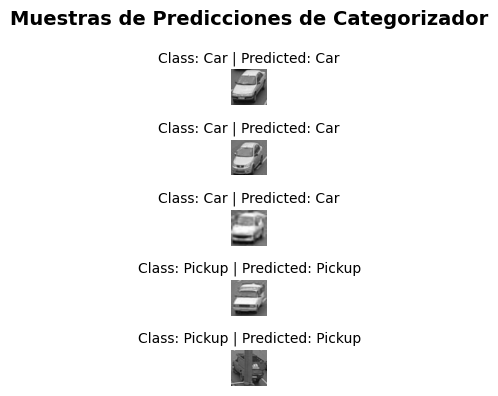

In [ ]:
clasificador = clasificador_por_modelo(model)

plot_clasificador_example(valid_loader, clasificador)


### **Evaluacion del Clasificador**

#### **Funciones Auxiliares**

In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score, precision_recall_fscore_support
import seaborn as sns
from sklearn.metrics import (
    accuracy_score,
    confusion_matrix,
    precision_recall_fscore_support,
    classification_report
)

# Imprime una matriz de confusion
def plot_confusion_matrix_heatmap(conf_matrix, target_names):

    plt.figure(figsize=(10, 8))

    sns.heatmap(
        conf_matrix,
        annot=True,
        fmt="d",
        cmap="Blues",
        cbar=True,
        xticklabels=target_names,
        yticklabels=target_names
    )

    plt.title('Confusion Matrix: True vs. Predicted')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.show()


# Evaluamos la metricas de un clasificador sobre un DataLoader
def calculate_metrics(classifier, dataloader):

    all_preds = []
    all_labels = []

    # Realizamos cada prediccion
    print("Empezando Evaluacion...")
    with torch.no_grad():
        for images, labels in dataloader:

            all_preds.extend(classifier(images))
            all_labels.extend(labels.cpu().numpy())

    print("Evaluacion Completa.")

    # Matriz de confusion
    conf_matrix = confusion_matrix(all_labels, all_preds)

    # Agarramos los nombres de las clases
    unique_labels = sorted(list(np.unique(all_labels)))
    target_names = [f"Class {i}" for i in unique_labels]

    # Creamos un reporte
    report = classification_report(
        all_labels,
        all_preds,
        target_names=target_names,
        zero_division=0,
        output_dict=False
    )

    print("\n" + "="*70)
    print("✨ Model Performance Summary ✨")
    print("="*70)
    print(report)

    # Matriz de confusion
    print("\n" + "="*70)
    print("🧩 Confusion Matrix (True vs. Predicted) 🧩")
    print("="*70)

    print("\n" + "="*70)
    print("📈 Plotting Confusion Matrix Heatmap...")
    print("="*70)
    plot_confusion_matrix_heatmap(conf_matrix, target_names)

    # Devolvemos las metricas
    accuracy = accuracy_score(all_labels, all_preds)
    precision, recall, f1_score, _ = precision_recall_fscore_support(
        all_labels, all_preds, average='weighted', zero_division=0
    )

    return {
        "overall_accuracy": accuracy,
        "weighted_precision": precision,
        "weighted_recall": recall,
        "weighted_f1_score": f1_score,
        "confusion_matrix": conf_matrix.tolist()
    }

#### **Evaluacion**

Empezando Evaluacion...
Evaluacion Completa.

✨ Model Performance Summary ✨
              precision    recall  f1-score   support

     Class 1       0.83      0.83      0.83         6
     Class 2       0.94      0.97      0.96       398
     Class 3       0.87      0.96      0.91        92
     Class 4       0.93      0.64      0.76        59
     Class 5       1.00      0.50      0.67         8

    accuracy                           0.93       563
   macro avg       0.91      0.78      0.83       563
weighted avg       0.93      0.93      0.92       563


🧩 Confusion Matrix (True vs. Predicted) 🧩

📈 Plotting Confusion Matrix Heatmap...


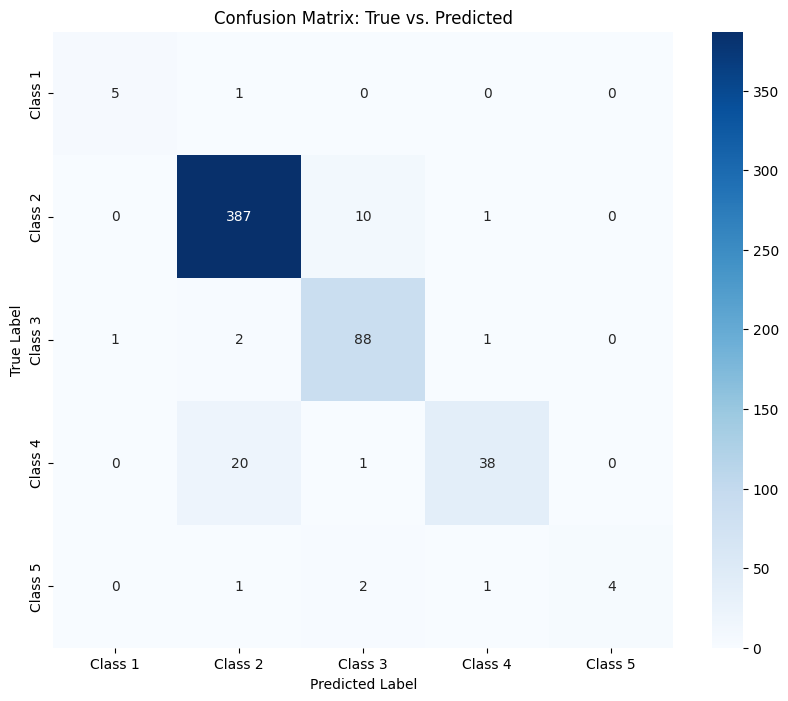

In [ ]:
calculate_metrics(clasificador, valid_loader)
pass

### ***Consigna***

Deberán implementar dos redes que difieran únicamente en su profundidad:

* Una arquitectura que contenga una **única Capa Convolucional**.

* Una arquitectura que contenga **tres Capas Convolucionales**.

Aseguren que, aparte de la cantidad de capas convolucionales, el resto de la arquitectura (La Parte Lineal) sea consistente.

Luego, entrenen cada una de las dos redes implementadas con el mismo conjunto de datos y el mismo número de épocas.

**Resultados y Discusión**:

Escriban un reporte de las métricas de precisión, recall y F1-score obtenidas para ambas redes.

**¿Hubo cambios significativos en el rendimiento de la red según su profundidad?**

**¿La red profunda fue más precisa? ¿Por qué sí o por qué no?**


In [ ]:
class BasicCNN_1(nn.Module):
    """
    Modulo de CNN Basica.
    Arquitectura: Conv -> Pool -> Linear
    Input: (Batch, 3, 64, 64)
    Output: (Batch, 5)
    """
    def __init__(self):
        super(BasicCNN_1, self).__init__()

        # Aplicaremos una normalizacion estandar antes de realizar el procesamiento
        self.normalize_transform = transforms.Normalize(
                                      mean=[0.485, 0.456, 0.406],
                                      std=[0.229, 0.224, 0.225]
                                   )

        # --- Extrator de Features (Capas Convolucionales) ---
        # nn.Sequential aplica una serie de operaciones de forma secuencial
        self.features = nn.Sequential(
            nn.Conv2d(in_channels=IMAGE_CHANNELS, out_channels=16, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )

        # --- Clasificador (Capas Lineales) ---
        # Tamano Flattened:
        # (3, 64, 64) -> (16, 64, 64)
        # (16, 64, 64) -> (16, 32, 32)
        tamaño_flattened = 16 * 32 * 32

        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(tamaño_flattened, 512), # Capa Oculta
            nn.ReLU(),
            nn.Linear(512, NUM_CLASSES)   # Output Final (Puntaje para cada Clase)
        )

    def forward(self, x):
        x = self.normalize_transform(x)
        x = self.features(x)
        x = self.classifier(x)
        return x

In [ ]:
class BasicCNN_3(nn.Module):
    """
    Modulo de CNN Basica.
    Arquitectura: Conv -> Pool -> Linear
    Input: (Batch, 3, 64, 64)
    Output: (Batch, 5)
    """
    def __init__(self):
        super(BasicCNN_3, self).__init__()

        # Aplicaremos una normalizacion estandar antes de realizar el procesamiento
        self.normalize_transform = transforms.Normalize(
                                      mean=[0.485, 0.456, 0.406],
                                      std=[0.229, 0.224, 0.225]
                                   )

        # --- Extrator de Features (Capas Convolucionales) ---
        # nn.Sequential aplica una serie de operaciones de forma secuencial
        self.features = nn.Sequential(
            # Primera capa
            nn.Conv2d(in_channels=IMAGE_CHANNELS, out_channels=16, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),

            # Segunda capa
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),

            # Tercera capa
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )


        # --- Clasificador (Capas Lineales) --
        # Tamano Flattened:
        """
          Primera capa:
            (3, 64, 64) -> (16, 64, 64)
            (16, 64, 64) -> (16, 32, 32)

          Segunda capa:
            (16, 32, 32) -> (32, 32, 32)
            (32, 32, 32) -> (32, 16, 16)

          Tercera capa:
            (32, 16, 16) -> (64, 16, 16)
            (64, 16, 16) -> (64, 8, 8)

        """
        tamaño_flattened = 64 * 8 * 8

        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(tamaño_flattened, 512), # Capa Oculta
            nn.ReLU(),
            nn.Linear(512, NUM_CLASSES)   # Output Final (Puntaje para cada Clase)
        )

    def forward(self, x):
        x = self.normalize_transform(x)
        x = self.features(x)
        x = self.classifier(x)
        return x

In [ ]:
# Inicializamos el modelo
model_1 = BasicCNN_1()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_1.to(device)

NUM_EPOCHS = 10
LR = 0.001

# Entrenar
train_model(model_1, train_loader, valid_loader, num_epochs=NUM_EPOCHS, learning_rate=LR)

Empezando entrenamiento en: cuda
Epoch 1/10: Train Loss: 0.7397, Valid Loss: 0.3441, Valid Accuracy: 88.28%
Epoch 2/10: Train Loss: 0.2851, Valid Loss: 0.3590, Valid Accuracy: 88.81%
Epoch 3/10: Train Loss: 0.2134, Valid Loss: 0.2932, Valid Accuracy: 90.94%
Epoch 4/10: Train Loss: 0.1483, Valid Loss: 0.2885, Valid Accuracy: 91.47%
Epoch 5/10: Train Loss: 0.1185, Valid Loss: 0.3341, Valid Accuracy: 91.30%
Epoch 6/10: Train Loss: 0.1242, Valid Loss: 0.2874, Valid Accuracy: 90.59%
Epoch 7/10: Train Loss: 0.0852, Valid Loss: 0.3577, Valid Accuracy: 90.59%
Epoch 8/10: Train Loss: 0.0623, Valid Loss: 0.3618, Valid Accuracy: 90.76%
Epoch 9/10: Train Loss: 0.0378, Valid Loss: 0.3528, Valid Accuracy: 90.76%
Epoch 10/10: Train Loss: 0.0376, Valid Loss: 0.3593, Valid Accuracy: 90.94%
Entrenamiento Terminado.


Empezando Evaluacion...
Evaluacion Completa.

✨ Model Performance Summary ✨
              precision    recall  f1-score   support

     Class 1       0.83      0.83      0.83         6
     Class 2       0.95      0.94      0.95       398
     Class 3       0.93      0.89      0.91        92
     Class 4       0.64      0.80      0.71        59
     Class 5       1.00      0.38      0.55         8

    accuracy                           0.91       563
   macro avg       0.87      0.77      0.79       563
weighted avg       0.92      0.91      0.91       563


🧩 Confusion Matrix (True vs. Predicted) 🧩

📈 Plotting Confusion Matrix Heatmap...


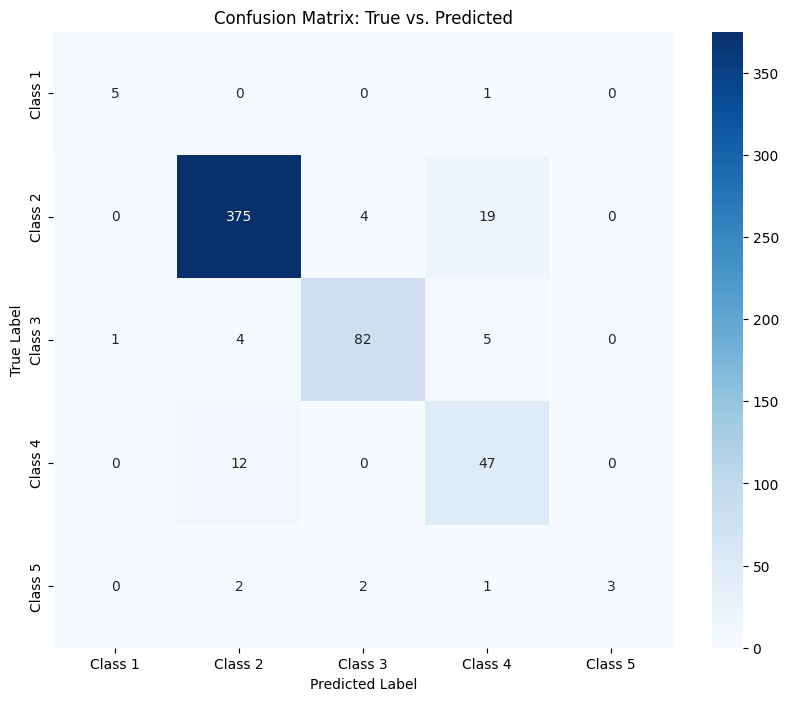

In [ ]:
clasificador_1 = clasificador_por_modelo(model_1)
calculate_metrics(clasificador_1, valid_loader)
pass

In [ ]:
# Inicializamos el modelo
model_3 = BasicCNN_3()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_3.to(device)

NUM_EPOCHS = 10
LR = 0.001

# Entrenar
train_model(model_3, train_loader, valid_loader, num_epochs=NUM_EPOCHS, learning_rate=LR)

Empezando entrenamiento en: cuda
Epoch 1/10: Train Loss: 0.5534, Valid Loss: 0.3985, Valid Accuracy: 86.50%
Epoch 2/10: Train Loss: 0.3182, Valid Loss: 0.3117, Valid Accuracy: 90.59%
Epoch 3/10: Train Loss: 0.2307, Valid Loss: 0.2901, Valid Accuracy: 91.65%
Epoch 4/10: Train Loss: 0.1659, Valid Loss: 0.2524, Valid Accuracy: 93.25%
Epoch 5/10: Train Loss: 0.1343, Valid Loss: 0.2570, Valid Accuracy: 92.72%
Epoch 6/10: Train Loss: 0.0883, Valid Loss: 0.2748, Valid Accuracy: 94.32%
Epoch 7/10: Train Loss: 0.0594, Valid Loss: 0.3946, Valid Accuracy: 92.90%
Epoch 8/10: Train Loss: 0.0524, Valid Loss: 0.3346, Valid Accuracy: 93.43%
Epoch 9/10: Train Loss: 0.0285, Valid Loss: 0.3338, Valid Accuracy: 92.36%
Epoch 10/10: Train Loss: 0.0261, Valid Loss: 0.3890, Valid Accuracy: 93.25%
Entrenamiento Terminado.


Empezando Evaluacion...
Evaluacion Completa.

✨ Model Performance Summary ✨
              precision    recall  f1-score   support

     Class 1       0.83      0.83      0.83         6
     Class 2       0.94      0.98      0.96       398
     Class 3       0.93      0.90      0.92        92
     Class 4       0.89      0.71      0.79        59
     Class 5       1.00      0.38      0.55         8

    accuracy                           0.93       563
   macro avg       0.92      0.76      0.81       563
weighted avg       0.93      0.93      0.93       563


🧩 Confusion Matrix (True vs. Predicted) 🧩

📈 Plotting Confusion Matrix Heatmap...


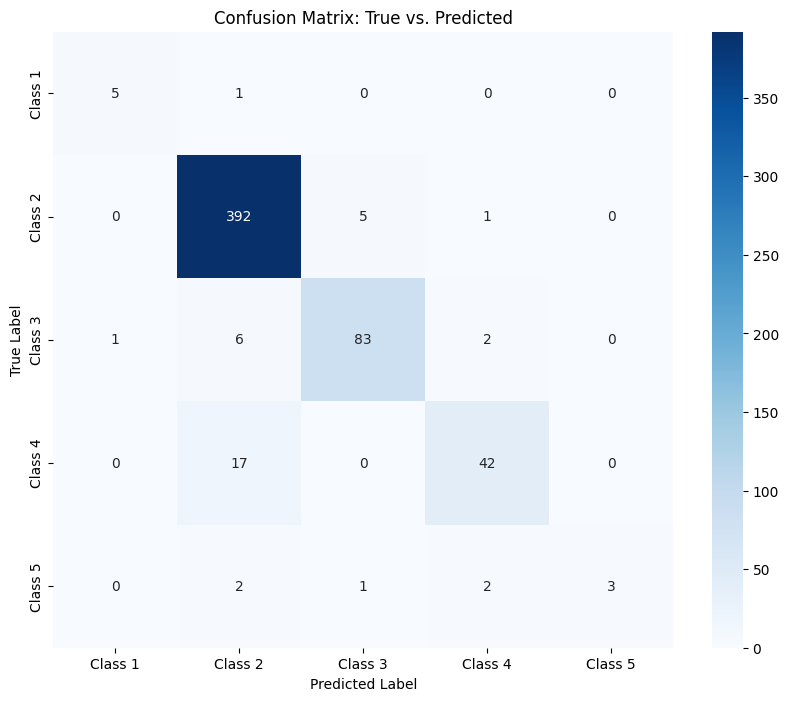

In [ ]:
clasificador_3 = clasificador_por_modelo(model_3)
calculate_metrics(clasificador_3, valid_loader)
pass

In [ ]:
def plot_per_class_comparasion(dataloader, classifier_1, classifier_2, class_names):

  device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

  def get_predictions(dataloader, model_1, model_2):
    all_labels = []
    all_preds_1 = []
    all_preds_2 = []

    with torch.no_grad():
      for images, labels in dataloader:
        labels_adjusted = (labels - 1).cpu().numpy()
        all_labels.extend(labels_adjusted)

        #Predicciones del modelo 1
        outputs_1 = model_1(images.to(device))
        preds_1 = torch.argmax(outputs_1, dim=1).cpu().numpy()
        all_preds_1.extend(preds_1)

        #Predicciones del modelo 2
        outputs_2 = model_2(images.to(device))
        preds_2 = torch.argmax(outputs_2, dim=1).cpu().numpy()
        all_preds_2.extend(preds_2)

    return all_labels, all_preds_1, all_preds_2


  #Obtenemos predicciones en ambos modelos
  all_labels, all_preds_1, all_preds_2 = get_predictions(dataloader, classifier_1, classifier_2)


  #Calculamos metricas por clase
  precision_1, recall_1, f1_1, _ = precision_recall_fscore_support(all_labels, all_preds_1, average=None, zero_division=0)
  precision_2, recall_2, f1_2, _ = precision_recall_fscore_support(all_labels, all_preds_2, average=None, zero_division=0)

  #Graficos
  fig, axes = plt.subplots(1, 3, figsize=(18, 5))
  x = np.arange(len(class_names))
  width = 0.35

  #Metricas para cada uno de los graficos + titulo + eje
  metrics_data = [
      (precision_1, precision_2, 'Precision', axes[0]),
      (recall_1, recall_2, 'Recall', axes[1]),
      (f1_1, f1_2, 'F1-Score', axes[2])
  ]

  for metric_1, metric_3, title, ax in metrics_data:
        bars1 = ax.bar(x - width/2, metric_1, width, label='CNN_1', color='blue', alpha=0.8)
        bars2 = ax.bar(x + width/2, metric_3, width, label='CNN_3', color='orange', alpha=0.8)

        ax.set_ylabel('Valor', fontsize=11, fontweight='bold')
        ax.set_title(f'{title} por Clase', fontsize=12, fontweight='bold')
        ax.set_xticks(x)
        ax.set_xticklabels(class_names)
        ax.legend()
        ax.grid(axis='y', alpha=0.3, linestyle='--')

        for bars in [bars1, bars2]:
            for bar in bars:
                height = bar.get_height()
                ax.annotate(f'{height:.2f}',xy=(bar.get_x() + bar.get_width() / 2, height),xytext=(0, 2),textcoords="offset points",ha='center', va='bottom', fontsize=8)

  plt.suptitle('Comparación de Métricas por Clase: CNN_1 vs CNN_3', fontsize=14, fontweight='bold', y=1.02)
  plt.tight_layout()
  plt.show()

In [ ]:
CATEGORIES_MAP = {
    0: "Bus",
    1: "Car",
    2: "Motorcycle",
    3: "Pickup",
    4: "Truck"
}
class_names = [CATEGORIES_MAP[i] for i in range(len(CATEGORIES_MAP))]

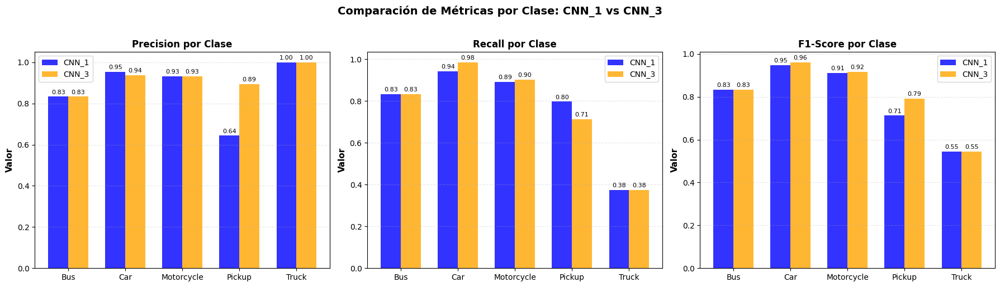

In [ ]:
plot_per_class_comparasion(valid_loader, model_1, model_3, class_names)

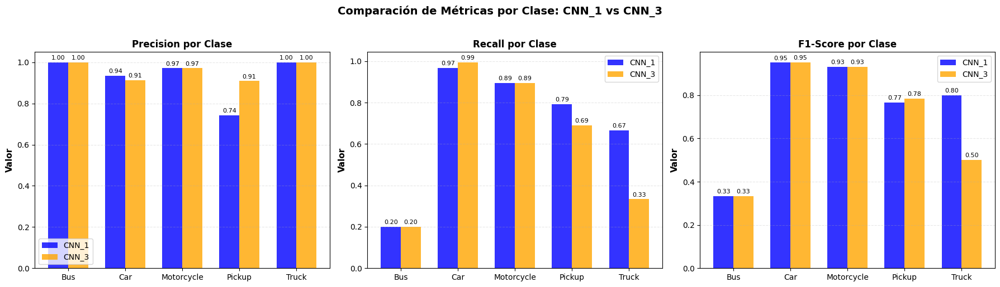

In [ ]:
plot_per_class_comparasion(test_loader, model_1, model_3, class_names)

***Respuestas:***

Hubo algunas mejoras significativos en el f1 de algunas clases. Particularmente en truck y pickup.

En si, la red más profunda tuvo un mejor rendimiento respecto al recall en truck y pickup lo cual provoca la significativa mejora en f1. A su vez, se mantienen semejantes o incrementan levemente los resultados para el resto de las clases.

Por otro lado, si hay hubo bajas de rendimiento significativas en las predicciones de la clase Bus y Truck de ambos modelos sobre el conjunto de test, lo cual puede indicar algún tipo de sobre-entrenamiento en los modelos, o una mala distribución o variabilidad de los datos entre conjuntos.

Queda evidenciado el como aumentar la cantidad de capas convolucionales puede mejorar la performance de la red en algunos casos. Seguramente esta mejora sea mucho más notoria sobre conjuntos con una mayor cantidad de datos y una mejor distribución.



### ***Clasificador Clasico***

***Consigna***

Creen su propio Clasificador sin utilizar redes neuronales, utilizando las tecnicas vistas en clase. Para busqueda de Hiper Parametros utilizar el conjunto de Validacion.

Reporten sus resultados y comparenlo con los del clasificador por CNN.

#### **Clasificador**

In [ ]:
import numpy as np
from skimage.feature import hog
from skimage.color import rgb2gray
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

In [ ]:
def hog_features(images):
    """
    images: np.array (B, H, W, C) en [0,1]
    retorna: np.array (B, D)
    """
    hog_features = []

    for img in images:
        # Convertimos a gris
        img_gray = rgb2gray(img)
        # Extraemos features
        features = hog(
            img_gray,
            orientations=9,
            pixels_per_cell=(8, 8),
            cells_per_block=(2, 2),
            block_norm="L2-Hys",
            transform_sqrt=True,
            feature_vector=True
        )

        hog_features.append(features)

    return np.array(hog_features)

def dataloader_to_hog(dataloader):
    X_list, y_list = [], []

    for images, labels in dataloader:
        images_np = numpy_format(images)
        hog_feats = hog_features(images_np)

        X_list.append(hog_feats)
        y_list.append(labels.numpy())

    X = np.vstack(X_list)
    y = np.concatenate(y_list)

    return X, y


In [ ]:
svm_clf = Pipeline([
    ("scaler", StandardScaler()),
    ("svm", LinearSVC(C=1.0, max_iter=1000))
])

X_train, y_train = dataloader_to_hog(train_loader)
X_valid, y_valid = dataloader_to_hog(valid_loader)

#svm_clf.fit(X_train, y_train)

#print("Accuracy train:", svm_clf.score(X_train, y_train))
#print("Accuracy valid:", svm_clf.score(X_valid, y_valid))

In [ ]:
#print(y_train[:100])

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#GUARDA EL MODELO
import joblib
#comentado para que no se ejecute
#joblib.dump(svm_clf, "/content/drive/MyDrive/imagenes/svm_hog_pipeline.joblib")

In [ ]:
#Carga el modelo
svm_clf = joblib.load("/content/drive/MyDrive/imagenes/svm_hog_pipeline.joblib")

In [ ]:
def clasificador_propio(imagenes):
    """
    imagenes: tensor (B, C, H, W)
    """
    images_np = numpy_format(imagenes)
    hog_feats = hog_features(images_np)
    return svm_clf.predict(hog_feats)

#### **Evaluacion del Clasificador**

Empezando Evaluacion...
Evaluacion Completa.

✨ Model Performance Summary ✨
              precision    recall  f1-score   support

     Class 1       0.60      0.50      0.55         6
     Class 2       0.92      0.93      0.93       398
     Class 3       0.84      0.83      0.83        92
     Class 4       0.61      0.56      0.58        59
     Class 5       0.50      0.62      0.56         8

    accuracy                           0.87       563
   macro avg       0.69      0.69      0.69       563
weighted avg       0.86      0.87      0.87       563


🧩 Confusion Matrix (True vs. Predicted) 🧩

📈 Plotting Confusion Matrix Heatmap...


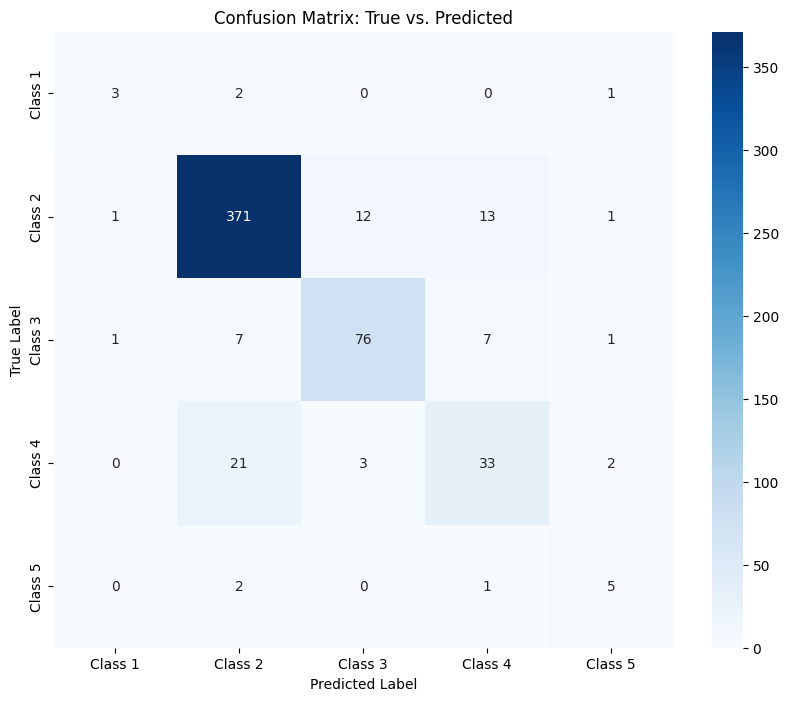

In [ ]:
calculate_metrics(clasificador_propio, valid_loader)
pass

***Consigna***


Finalmente Registren sus resultados del Clasificador con CNN (2 capas Convolucionales) y el Clasificador Clasico contra el Conjunto de Test.

In [ ]:
def plot_per_class_comparasion(dataloader, classifier_1, classifier_2, class_names):

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    def get_predictions(dataloader, model_1, model_2):
        all_labels = []
        all_preds_1 = []
        all_preds_2 = []

        with torch.no_grad():
            for images, labels in dataloader:

                # Ajuste de labels (dejalo SOLO si tus labels originales empiezan en 1)
                labels_np = (labels - 1).cpu().numpy()
                all_labels.extend(labels_np)

                # -------- MODELO 1: NN (logits) --------
                outputs_1 = model_1(images.to(device))

                if isinstance(outputs_1, np.ndarray):
                    outputs_1 = torch.from_numpy(outputs_1)

                preds_1 = torch.argmax(outputs_1, dim=1).cpu().numpy()
                all_preds_1.extend(preds_1)

                # -------- MODELO 2: CLÁSICO (SVM / HOG) --------
                outputs_2 = classifier_2(images)

                all_preds_2.extend(outputs_2-1)

        return np.array(all_labels), np.array(all_preds_1), np.array(all_preds_2)

    # ------------------ PREDICCIONES ------------------
    all_labels, all_preds_1, all_preds_2 = get_predictions(
        dataloader, classifier_1, classifier_2
    )

    # ------------------ MÉTRICAS (BLINDADAS) ------------------
    num_classes = len(class_names)
    labels_range = np.unique(all_labels)

    precision_1, recall_1, f1_1, _ = precision_recall_fscore_support(
        all_labels, all_preds_1,
        labels=labels_range,
        average=None,
        zero_division=0
    )
    precision_2, recall_2, f1_2, _ = precision_recall_fscore_support(
        all_labels, all_preds_2,
        labels=labels_range,
        average=None,
        zero_division=0
    )
    # ------------------ GRÁFICOS ------------------
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    x = np.arange(num_classes)
    width = 0.35

    metrics_data = [
        (precision_1, precision_2, 'Precision', axes[0]),
        (recall_1, recall_2, 'Recall', axes[1]),
        (f1_1, f1_2, 'F1-Score', axes[2])
    ]

    for metric_1, metric_2, title, ax in metrics_data:
        bars1 = ax.bar(x - width / 2, metric_1, width,
                       label='NN', alpha=0.8)
        bars2 = ax.bar(x + width / 2, metric_2, width,
                       label='Clásico', alpha=0.8)

        ax.set_ylabel('Valor', fontsize=11, fontweight='bold')
        ax.set_title(f'{title} por Clase', fontsize=12, fontweight='bold')
        ax.set_xticks(x)
        ax.set_xticklabels(class_names)
        ax.legend()
        ax.grid(axis='y', alpha=0.3, linestyle='--')

        for bars in (bars1, bars2):
            for bar in bars:
                height = bar.get_height()
                ax.annotate(
                    f'{height:.2f}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 2),
                    textcoords="offset points",
                    ha='center',
                    va='bottom',
                    fontsize=8
                )

    plt.suptitle(
        'Comparación de Métricas por Clase: NN vs Clasificador Clásico',
        fontsize=14,
        fontweight='bold',
        y=1.02
    )
    plt.tight_layout()
    plt.show()

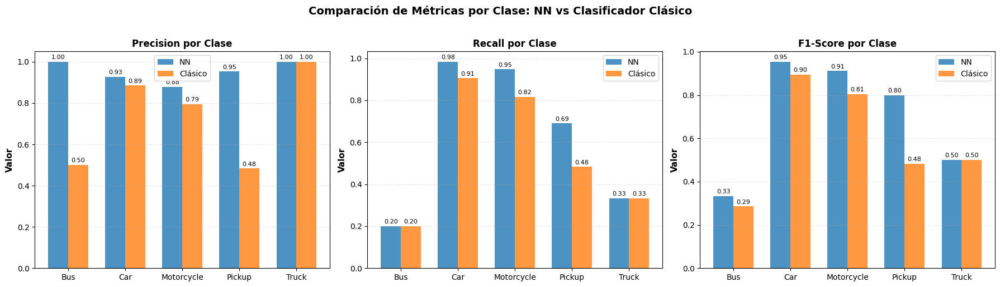

In [ ]:
plot_per_class_comparasion(test_loader, model, clasificador_propio, class_names)

## ***Ejercicio Opcional***

***Consigna***

Unan el segmentador y clasificador, de tal forma que dado un video, recuperen las bbox de cada frame y su categoria.

Prueben su implementacion en un video corto grabado por ustedes.

In [ ]:
import cv2

def vehicle_segmentator_adapter(frames, *args, **kwargs):
    global create_video_from_frame
    original_create_video_from_frame = create_video_from_frame

    def adapted_create_video_from_frame(frames_input):
        if len(frames_input) > 0 and isinstance(frames_input[0], np.ndarray):
            return np.asarray([to_gray(f) for f in frames_input])
        return original_create_video_from_frame(frames_input)

    create_video_from_frame = adapted_create_video_from_frame
    try:
        return vehicle_segmentator(frames, *args, **kwargs)
    finally:
        create_video_from_frame = original_create_video_from_frame

def load_video_frames(video_path, max_frames=None):
    cap = cv2.VideoCapture(video_path)
    frames = []
    while True:
        if max_frames is not None and len(frames) >= max_frames:
            break
        ret, frame = cap.read()
        if not ret: break
        frames.append(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    cap.release()
    return frames

def visualize_video_results(bboxes, binary_frames, proced_frames):
    for frame in range(len(proced_frames)):
        annotations = []
        for boxes_frame in bboxes[frame]:
            annotations.append({"bbox" : boxes_frame})

        draw_bboxes_img_and_binary(proced_frames[frame], binary_frames[frame], annotations)

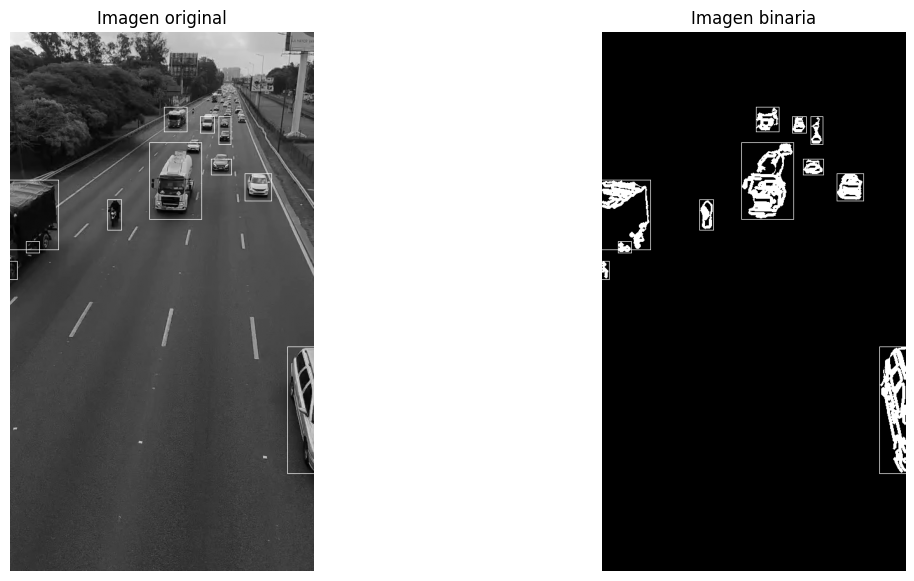

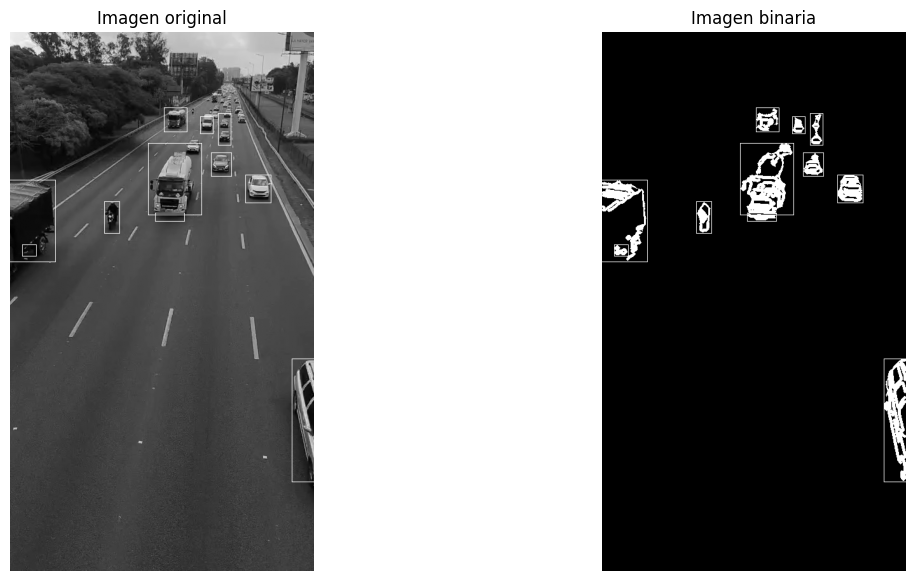

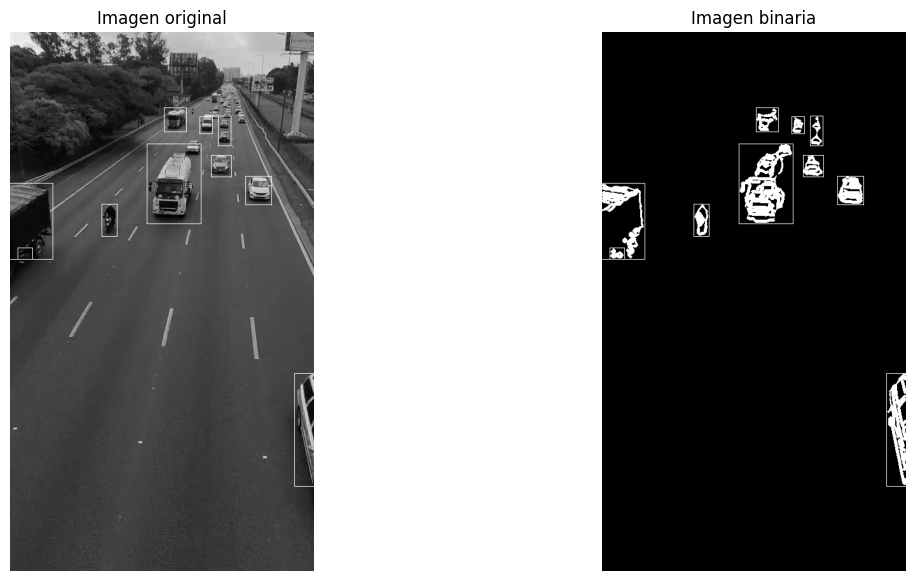

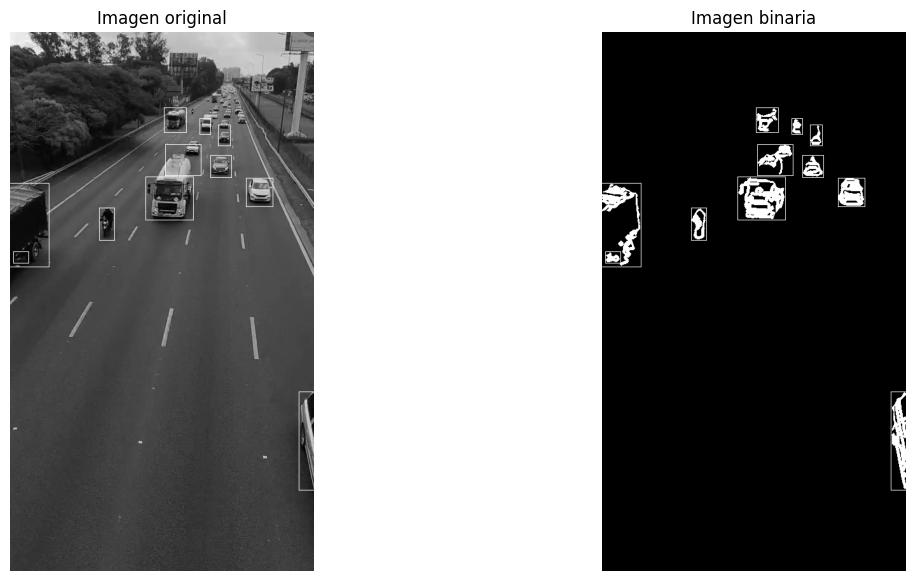

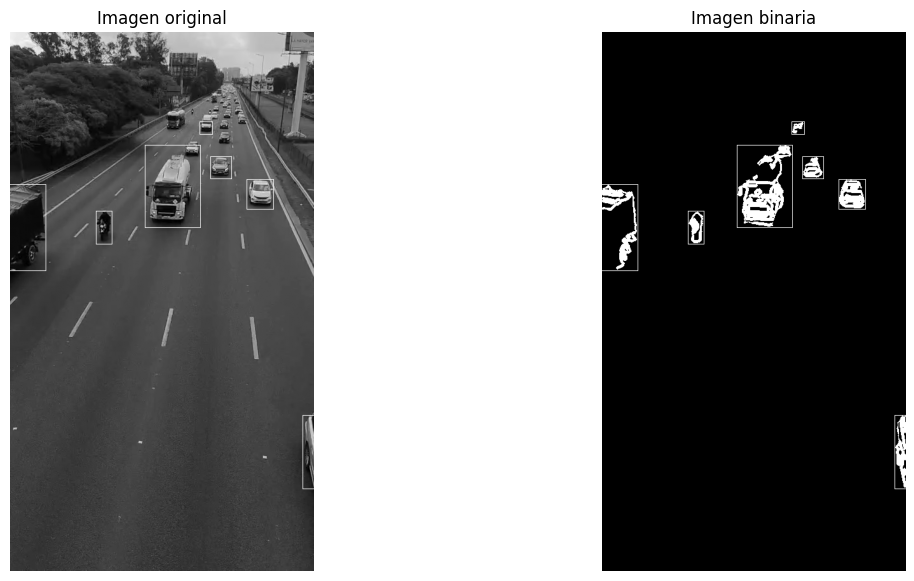

...

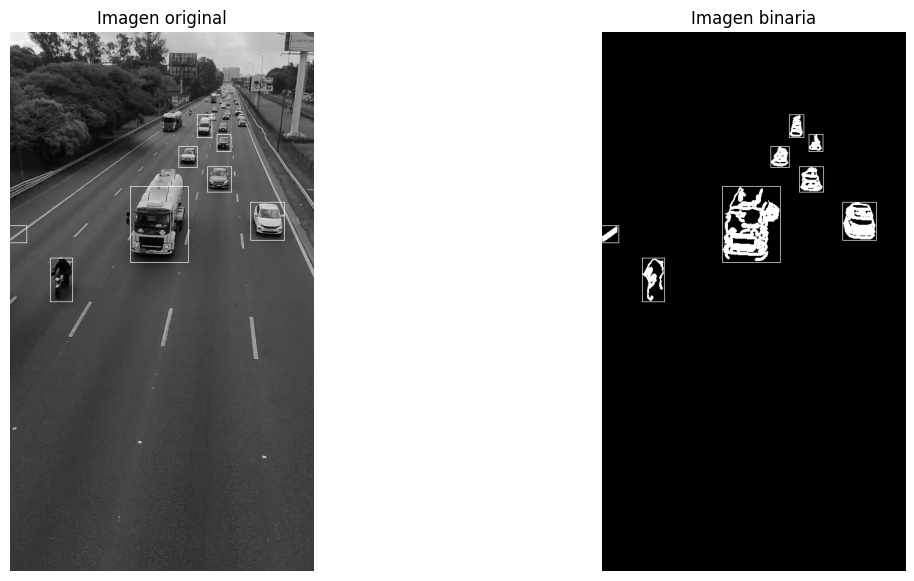

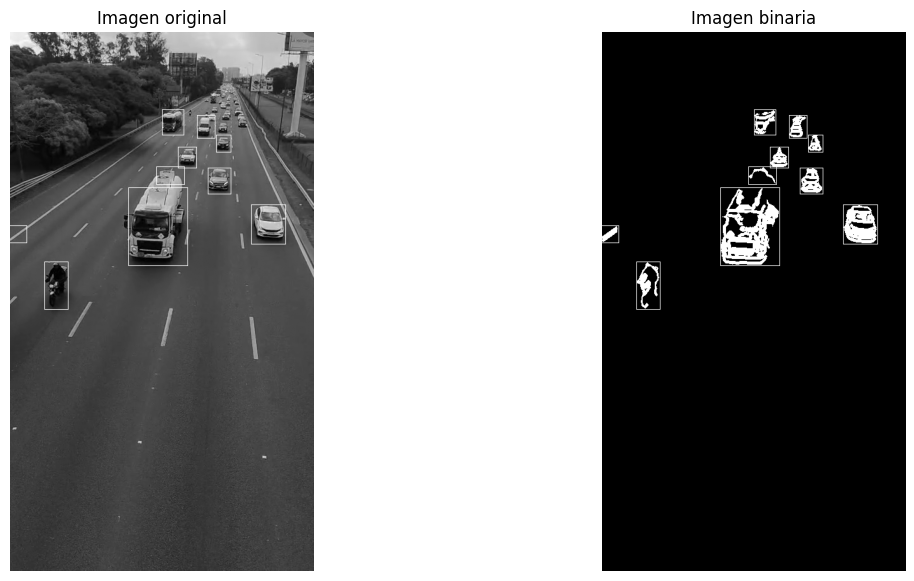

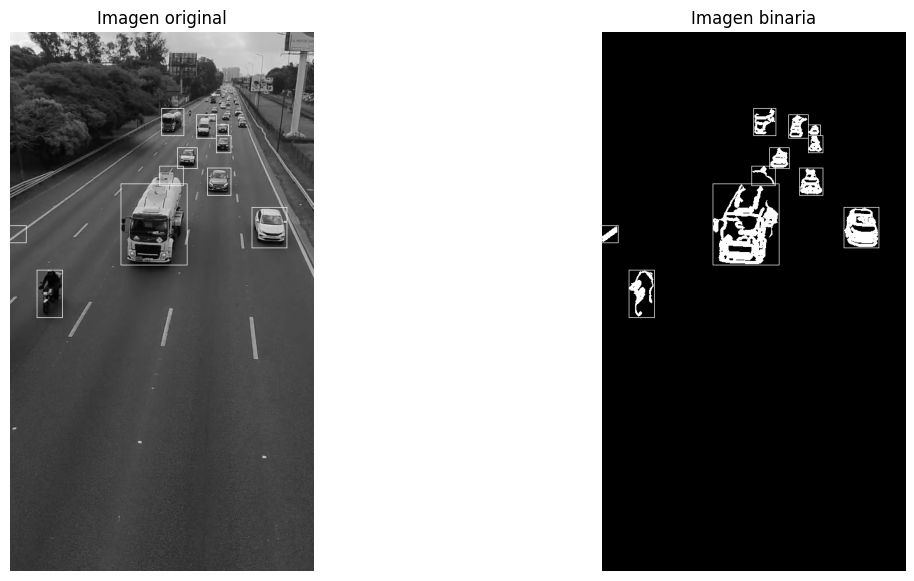

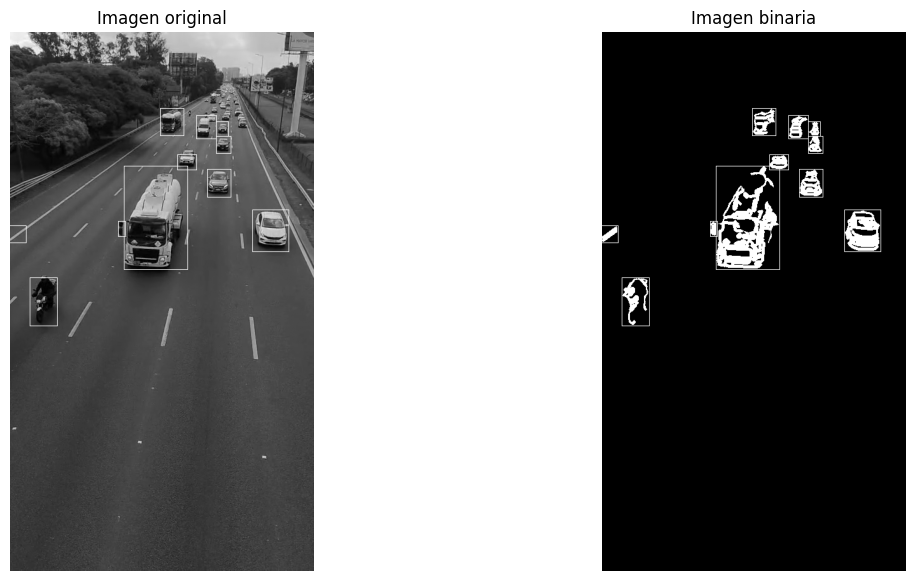

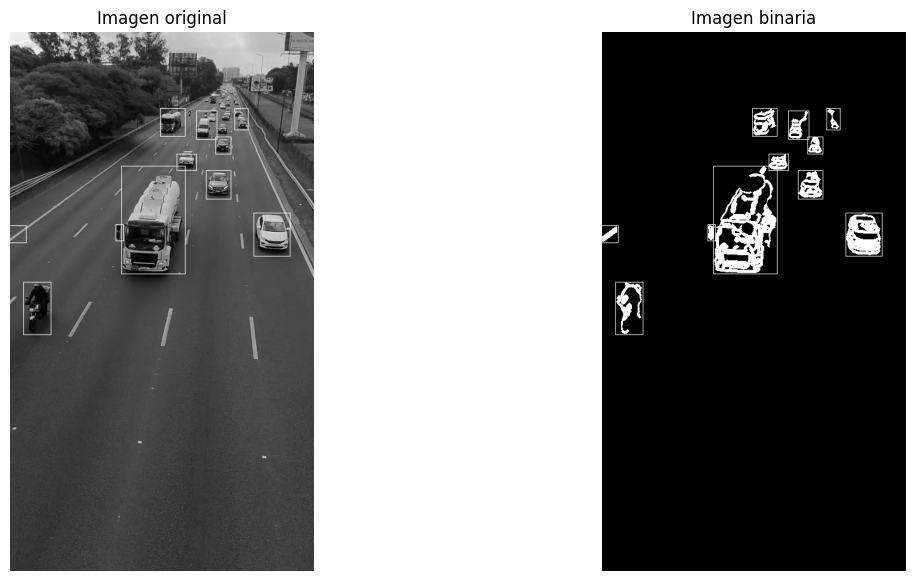

In [ ]:
video_frames = load_video_frames('VID-20251218-WA0000.mp4', max_frames=20)
bboxes, binary_frames, proced_frames = vehicle_segmentator_adapter(video_frames, RetournBinaryFrames=True, PrintBackground=False)
visualize_video_results(bboxes, binary_frames, proced_frames)

In [ ]:
from torchvision import transforms

transform_pipeline = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((64, 64)),
    transforms.Grayscale(num_output_channels=3),
    transforms.ToTensor(),
])

def classify_and_visualize_video_results(bboxes, binary_frames, proced_frames, classifier, categories):
    categories_list = [{"id": k, "name": v} for k, v in categories.items()]

    for frame_idx in range(len(proced_frames)):
        frame_img = proced_frames[frame_idx]
        annotations = []

        for bbox in bboxes[frame_idx]:
            x, y, w, h = bbox

            crop = frame_img[y:y+h, x:x+w]

            crop_tensor = transform_pipeline(crop)
            crop_batch = crop_tensor.unsqueeze(0)

            output = classifier(crop_batch.to(device))

            if isinstance(output, torch.Tensor):
              prediction = torch.argmax(output, dim=1).cpu().numpy()
            else:
              prediction = output

            category_id = prediction[0]

            annotations.append({
                "bbox": bbox,
                "category_id": category_id
            })

        draw_bboxes_img_and_binary(frame_img, binary_frames[frame_idx], annotations, categories=categories_list)

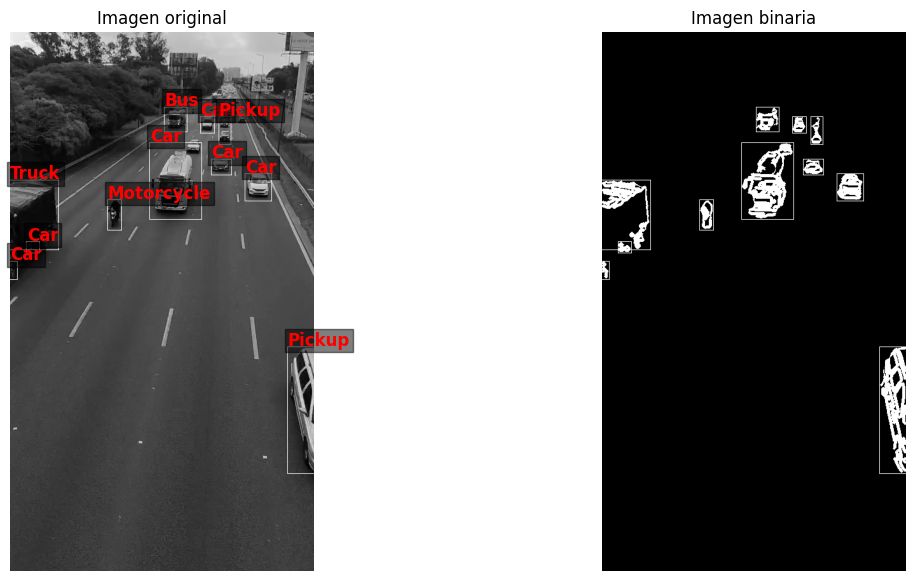

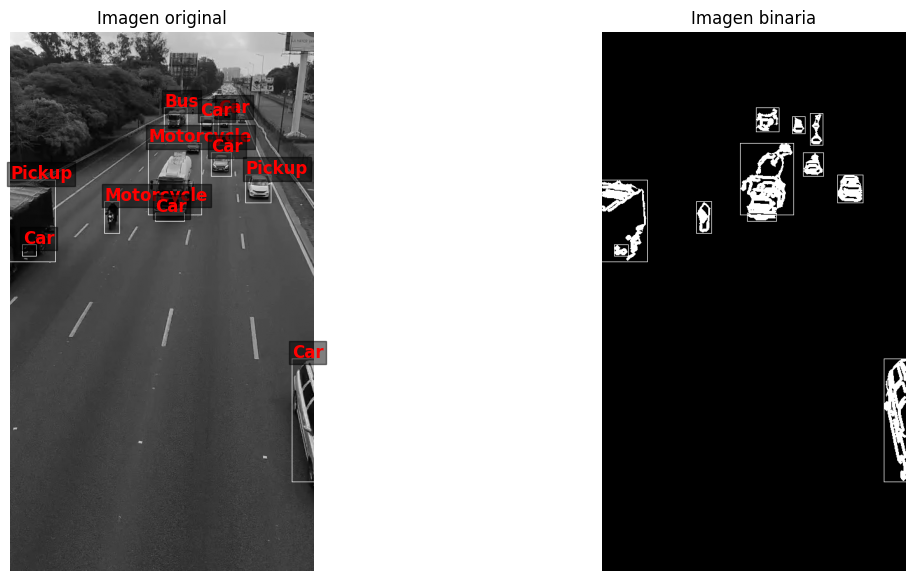

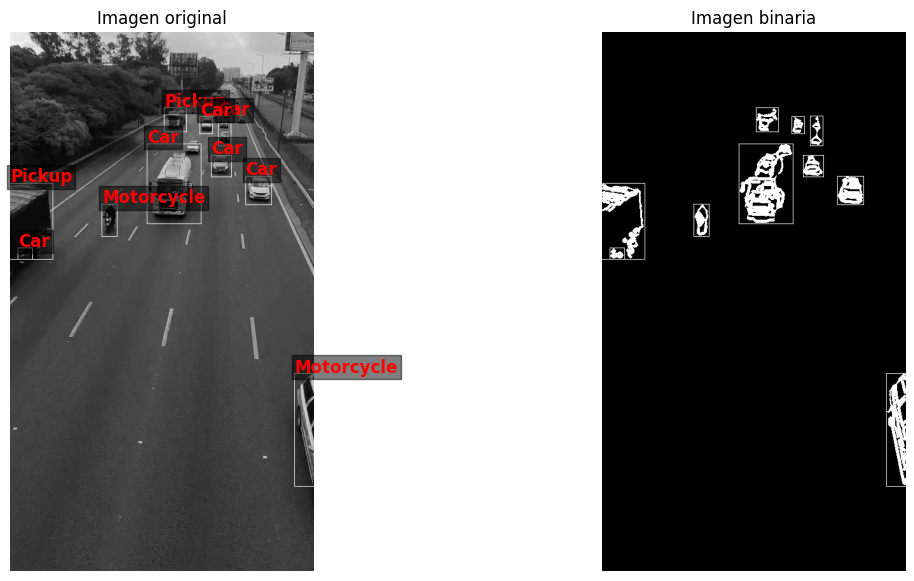

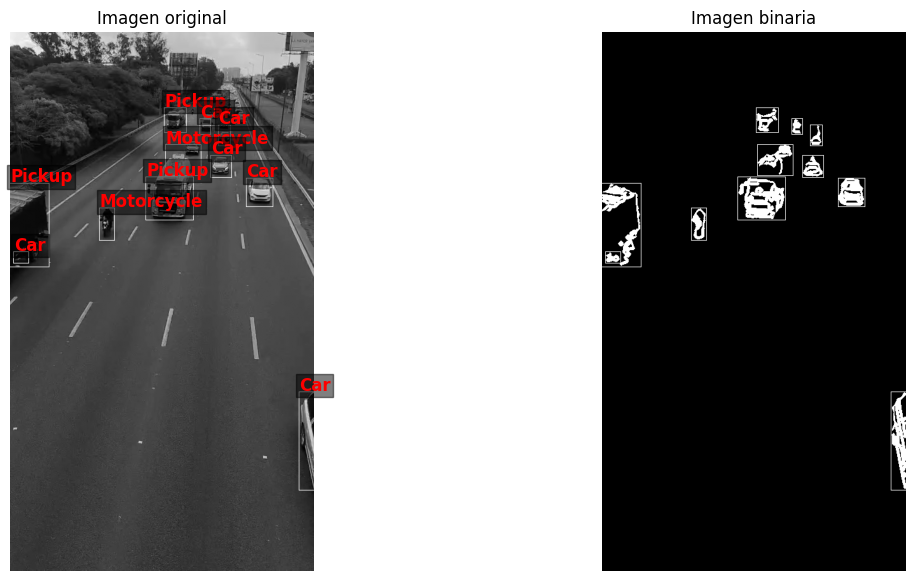

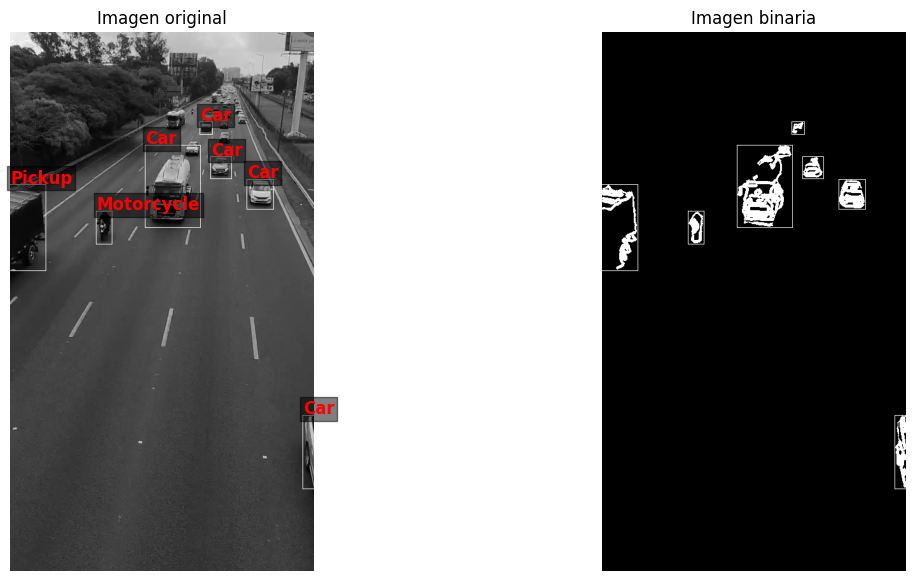

...

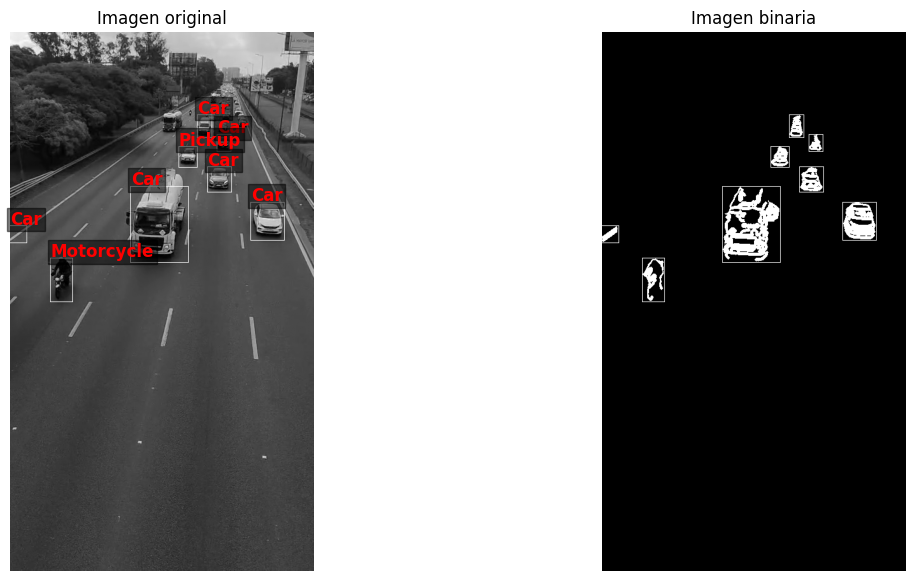

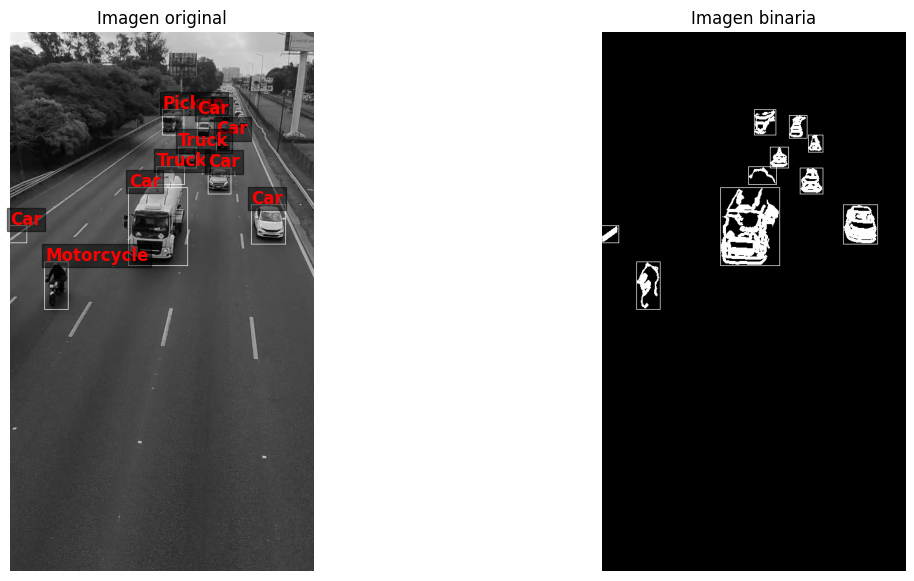

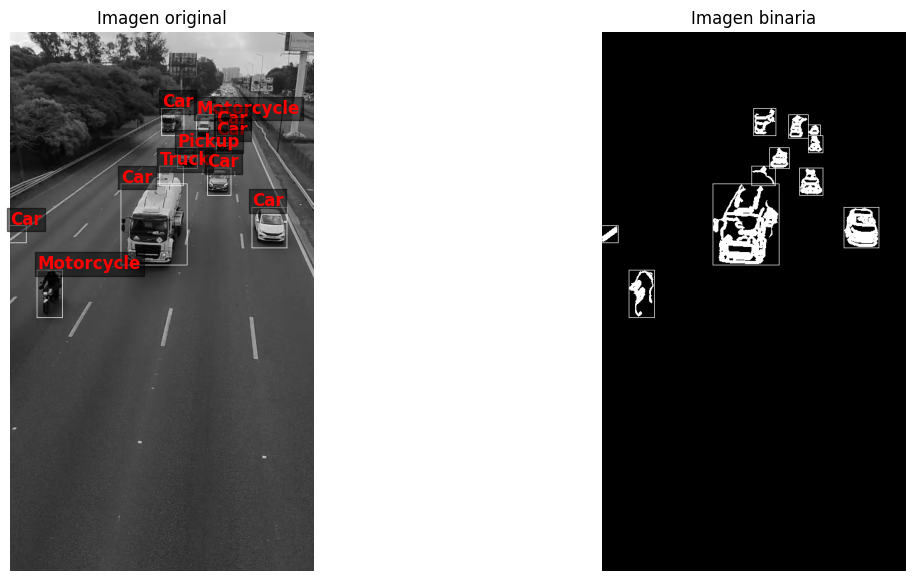

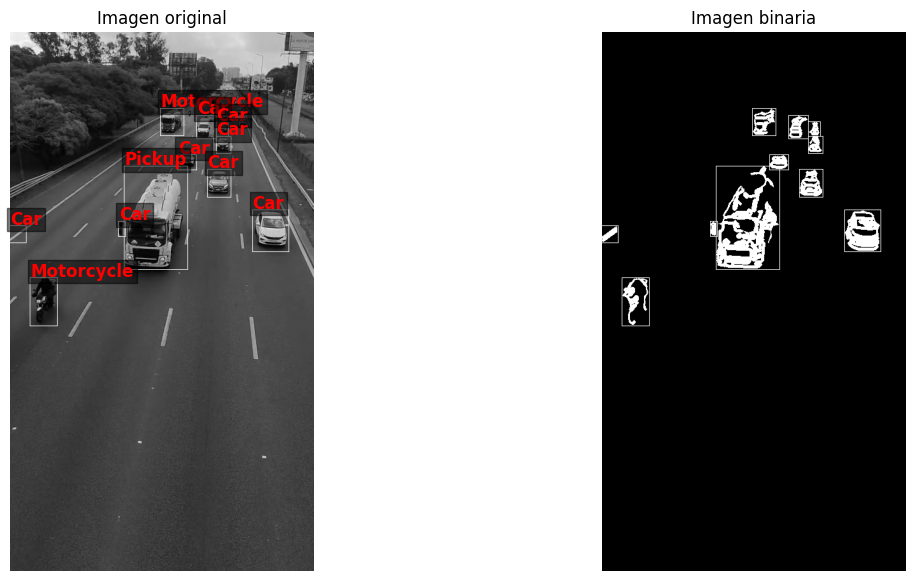

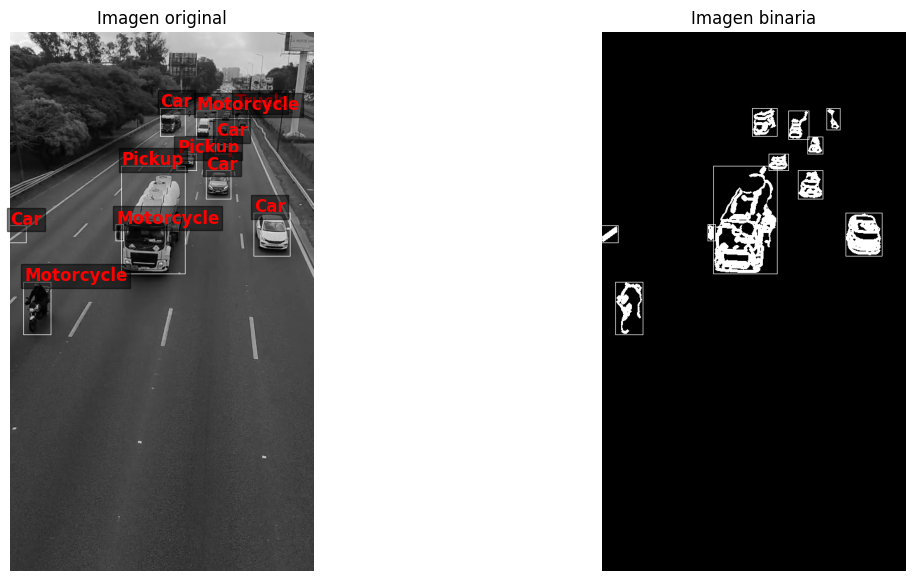

In [ ]:
classify_and_visualize_video_results(bboxes, binary_frames, proced_frames, clasificador_propio, CATEGORIES)

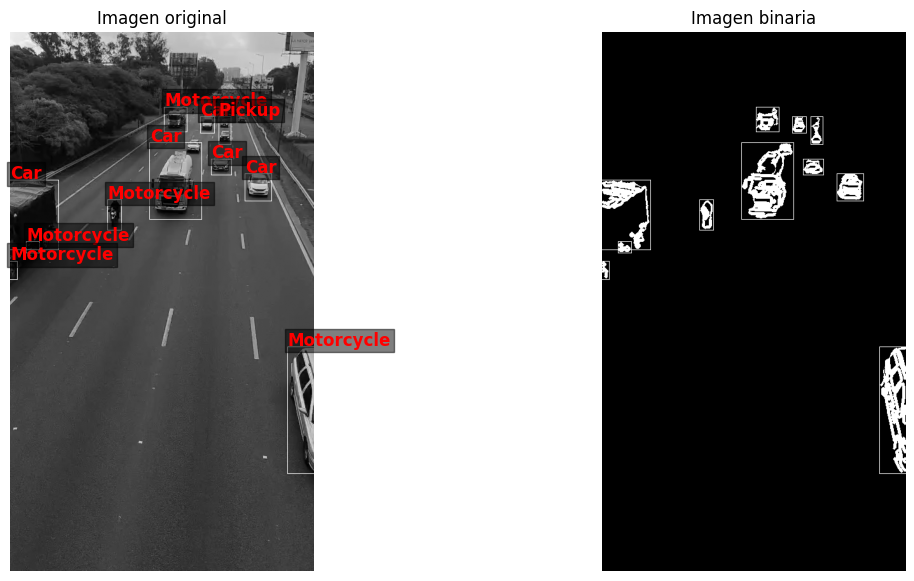

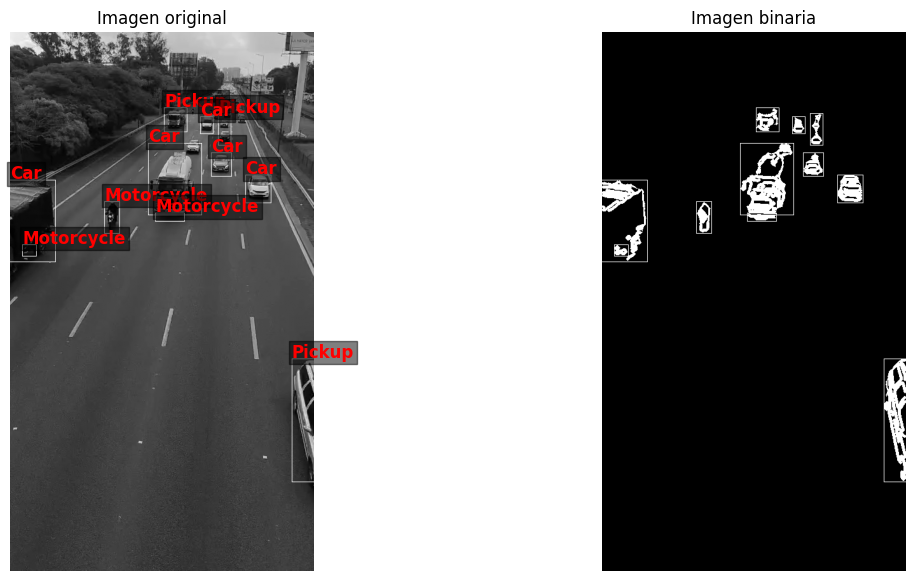

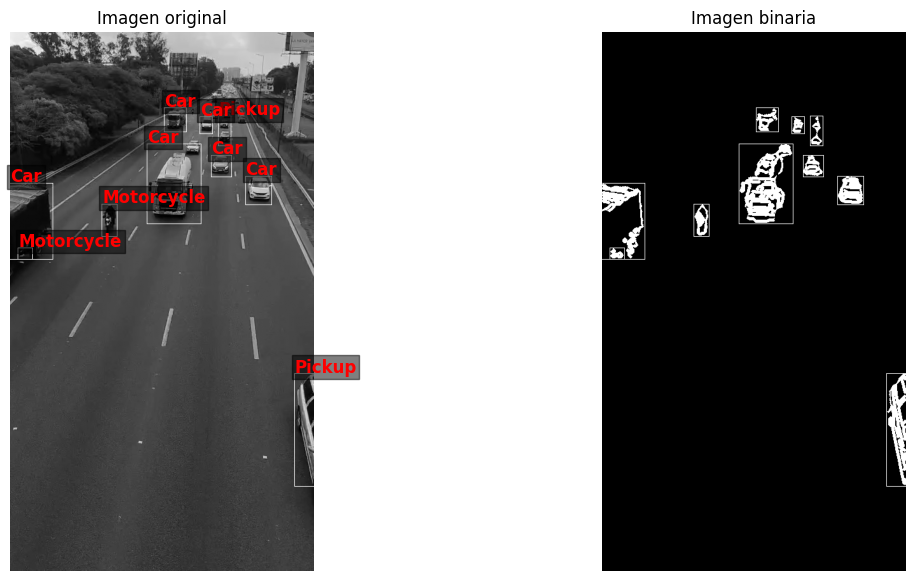

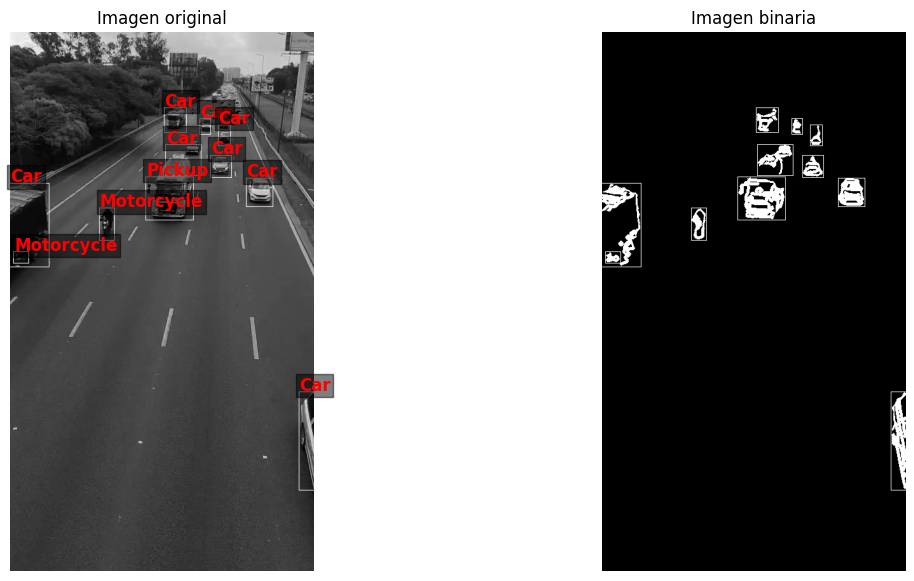

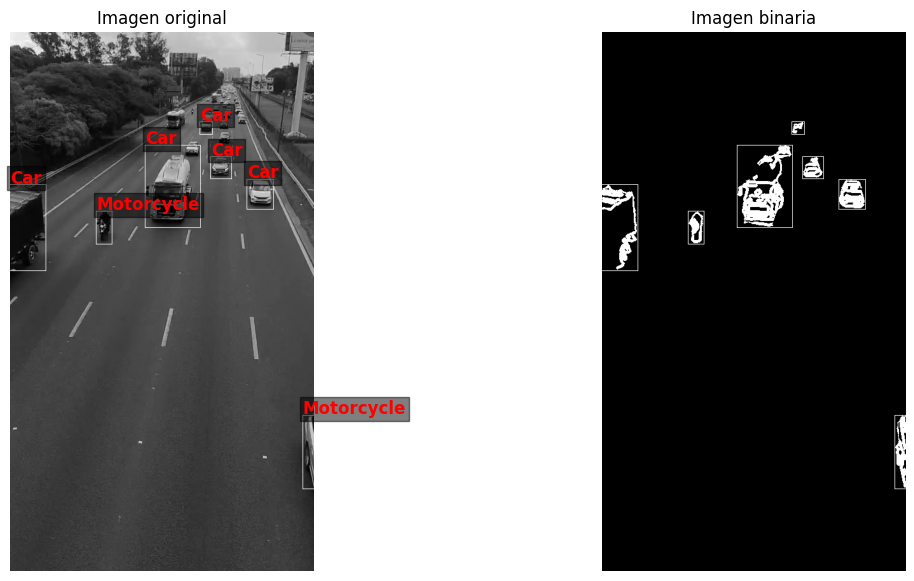

...

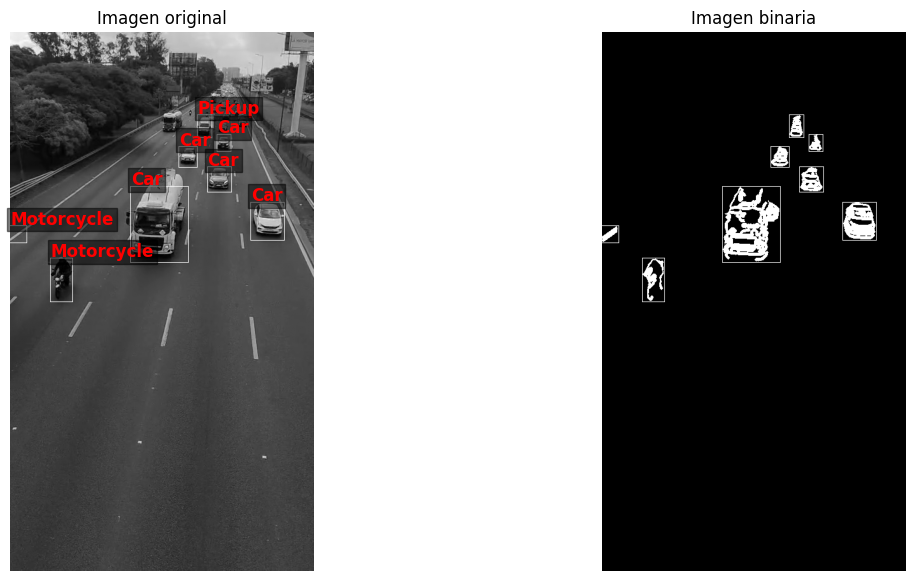

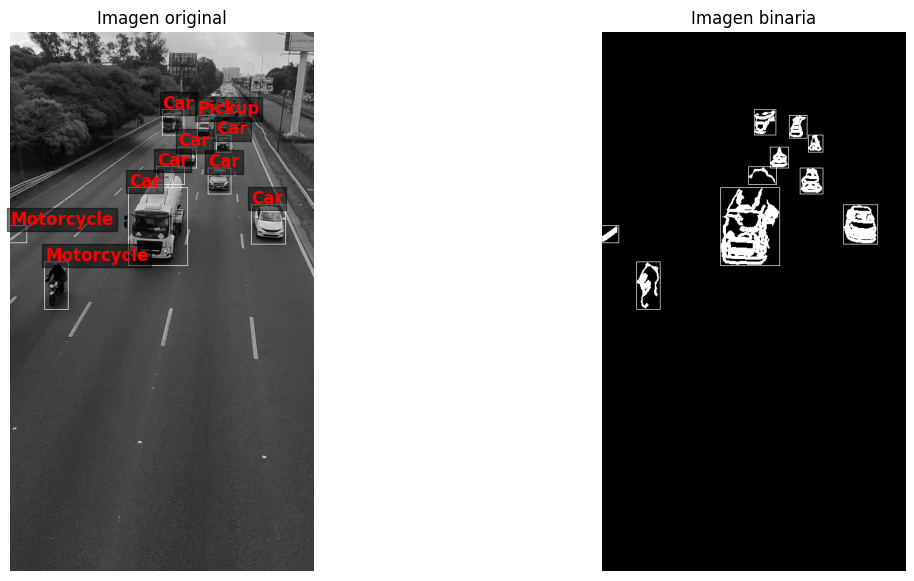

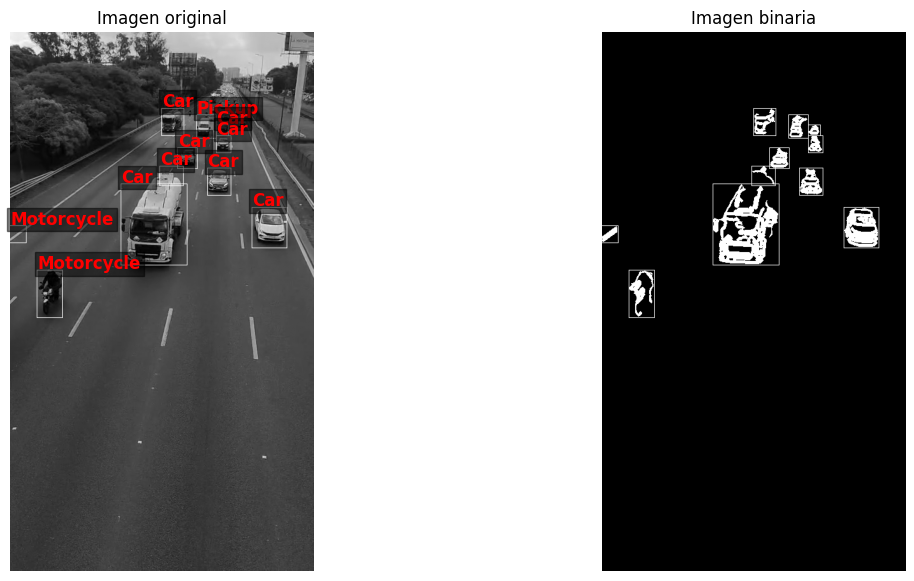

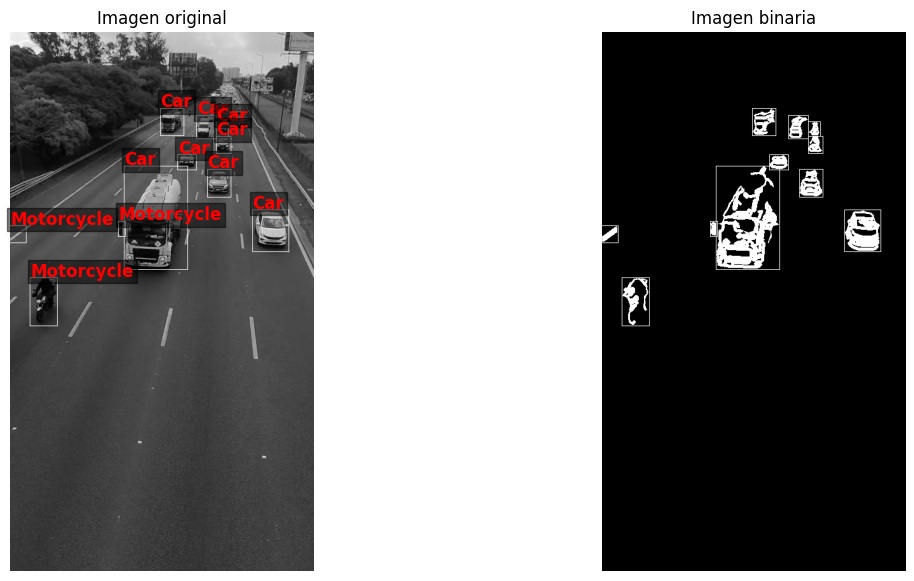

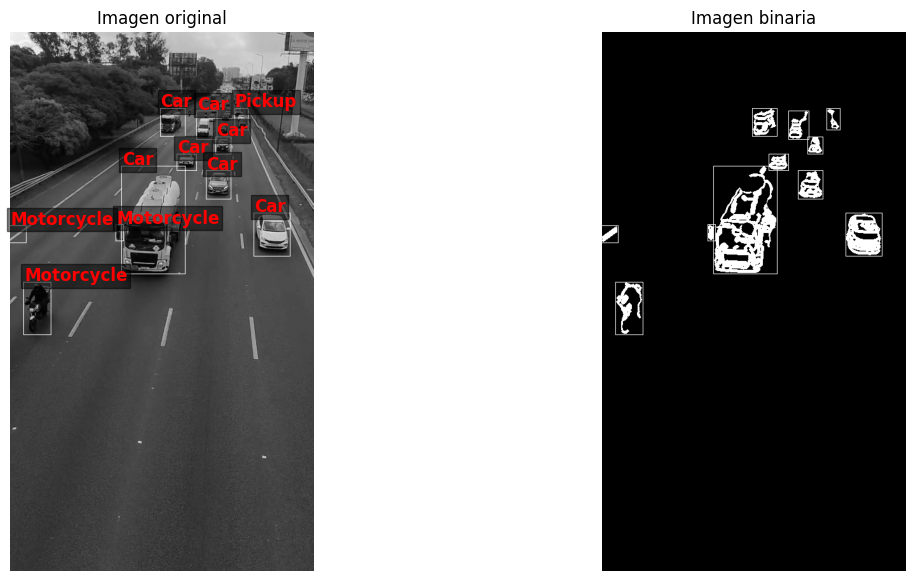

In [ ]:
classify_and_visualize_video_results(bboxes, binary_frames, proced_frames, model_3, CATEGORIES_MAP)